# Imports

In [2]:
import numpy as np
import os
import sys
import pickle
import scipy
import pandas as pd

import matplotlib.pyplot as plt
import networkx as nx
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.cm import ScalarMappable

from pycirclize import Circos

## Helper Functions

In [3]:
%store -r analysis_hf
sys.path.insert(0, analysis_hf)

import fixedDensity as fd
import circularPlot as cp

# Set Directory Paths

In [4]:
# Directory path to load formatted Layer Data
%store -r layer_dataDir

# Directory path to save Calcualted Analysis Data
%store -r layer_CalData

# Directory path to save Figures
%store -r layer_Fig

# Loading

## Loading Covariance Matrices

In [85]:
# cov_NeuN_dict
with open(os.path.join(layer_CalData, 'cov_NeuN_dict.pkl'), 'rb') as f:
    cov_NeuN_dict = pickle.load(f)
f.close()

# cov_NeuN_dict_w
with open(os.path.join(layer_CalData, 'cov_NeuN_dict_w.pkl'), 'rb') as f:
    cov_NeuN_dict_w = pickle.load(f)
f.close()

## Loading Layer Neuron Labels (NeuN)

In [86]:
# NeuN_Labels
with open(os.path.join(layer_dataDir, 'NeuN_Labels.pkl'), 'rb') as f:
    NeuN_Labels = pickle.load(f)
f.close()

# Draw Graph Networks (NeuN)

## Define Variables

### Label Order

In [87]:
order = ['L23_1', 'L56_1', 'L23_2', 'L56_2', 'L23_3', 'L56_3', 'L23_4', 'L56_4', 'L23_5', 'L56_5']

### Color Dictionary

In [88]:
color_dict = {'L23_1' : 'red', 'L56_1' : '#FFB6C1', 
              'L23_2' : 'orange', 'L56_2' : '#FFD700',
              'L23_3' : 'green', 'L56_3' : '#98FB98',
              'L23_4' : 'blue', 'L56_4' : '#ADD8E6',
              'L23_5' : 'purple', 'L56_5' : '#E6E6FA'}
              
#     'L23_1': {'original': 'red', 'pastel': '#FFB6C1'},    # Red and Pastel Red
#     'L56_1': {'original': 'blue', 'pastel': '#ADD8E6'},   # Blue and Pastel Blue
#     'L23_2': {'original': 'green', 'pastel': '#98FB98'},  # Green and Pastel Green
#     'L56_2': {'original': 'purple', 'pastel': '#E6E6FA'}, # Purple and Pastel Purple
#     'L23_3': {'original': 'orange', 'pastel': '#FFD700'}, # Orange and Pastel Orange
#     'L56_3': {'original': 'yellow', 'pastel': '#FFFFE0'}, # Yellow and Pastel Yellow
#     'L23_4': {'original': 'brown', 'pastel': '#D2B48C'},  # Brown and Pastel Brown
#     'L56_4': {'original': 'pink', 'pastel': '#FFC0CB'},   # Pink and Pastel Pink
#     'L23_5': {'original': 'cyan', 'pastel': '#00FFFF'},   # Cyan and Pastel Cyan
#     'L56_5': {'original': 'gray', 'pastel': '#D3D3D3'}   # Gray and Pastel Gray
# }

### Set fixed density value 

In [89]:
fd_val = 10

### Long Track

In [90]:
long_track = [('L23_4', 'L56_2'), ('L23_5', 'L56_2')]

### Short Track

In [91]:
short_track = [('L23_2', 'L56_1'), ('L23_3', 'L56_2'), ('L23_4', 'L56_2'), ('L23_5', 'L56_2'), 
               ('L23_4', 'L56_3'), ('L23_5', 'L56_4')]

## Region 1, 2, 3

In [92]:
reg_123 = [('L23_1', 'L23_2'), ('L23_1', 'L23_3'), ('L23_1', 'L56_1'), ('L23_1', 'L56_2'), ('L23_1', 'L56_3'), 
           ('L23_2', 'L23_3'), ('L23_2', 'L56_1'), ('L23_2', 'L56_2'), ('L23_2', 'L56_3'), 
           ('L23_3', 'L56_1'), ('L23_3', 'L56_2'), ('L23_3', 'L56_3'),
           ('L56_1', 'L56_2'), ('L56_1', 'L56_3'), 
           ('L56_2', 'L56_3')]

## Region 2, 4, 5

In [93]:
reg_245 = [('L23_2', 'L23_4'), ('L23_2', 'L23_5'), ('L23_2', 'L56_2'), ('L23_2', 'L56_4'), ('L23_2', 'L56_5'), 
           ('L23_4', 'L23_5'), ('L23_4', 'L56_2'), ('L23_4', 'L56_4'), ('L23_4', 'L56_5'), 
           ('L23_5', 'L56_2'), ('L23_5', 'L56_4'), ('L23_5', 'L56_5'),
           ('L56_2', 'L56_4'), ('L56_2', 'L56_5'), 
           ('L56_4', 'L56_5')]

### Define Variables

In [94]:
# Variable setting
neuron_type = "NeuN"

cov_dict = cov_NeuN_dict

data_label = NeuN_Labels

### Generate Dict for Node Name Assignment

In [95]:
labels_dict = {}

node_num = 0

for label in data_label:
    labels_dict[node_num] = label
    node_num += 1

print(labels_dict)

{0: 'L23_1', 1: 'L23_2', 2: 'L23_3', 3: 'L23_4', 4: 'L23_5', 5: 'L56_1', 6: 'L56_2', 7: 'L56_3', 8: 'L56_4', 9: 'L56_5'}


## HC

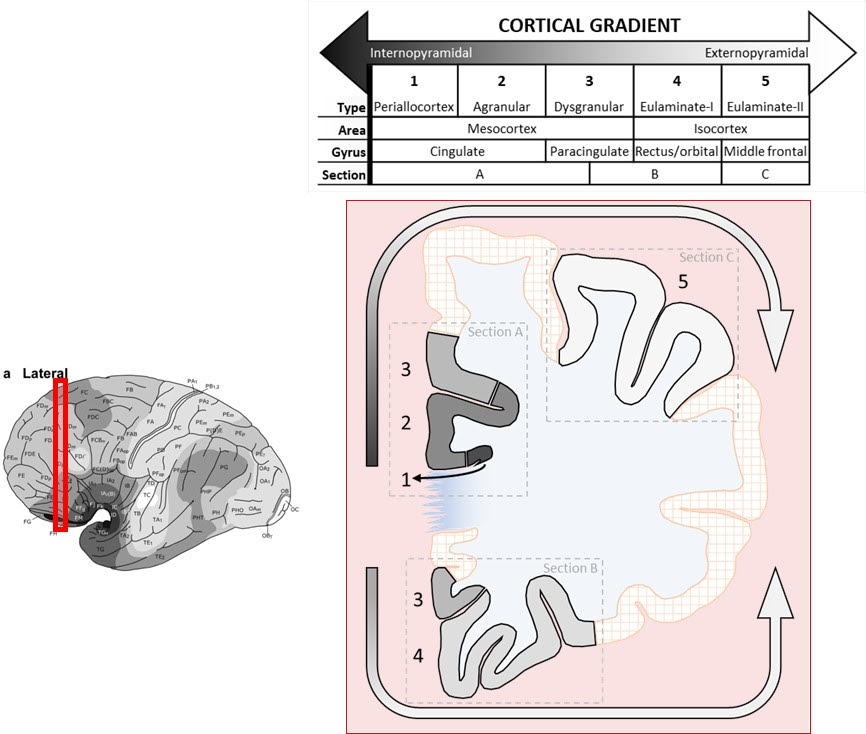

Focus on 1, 4, 5 cortical types --> FeedForward Loop

vs FeedBackward Loop

vs Unclear pathways

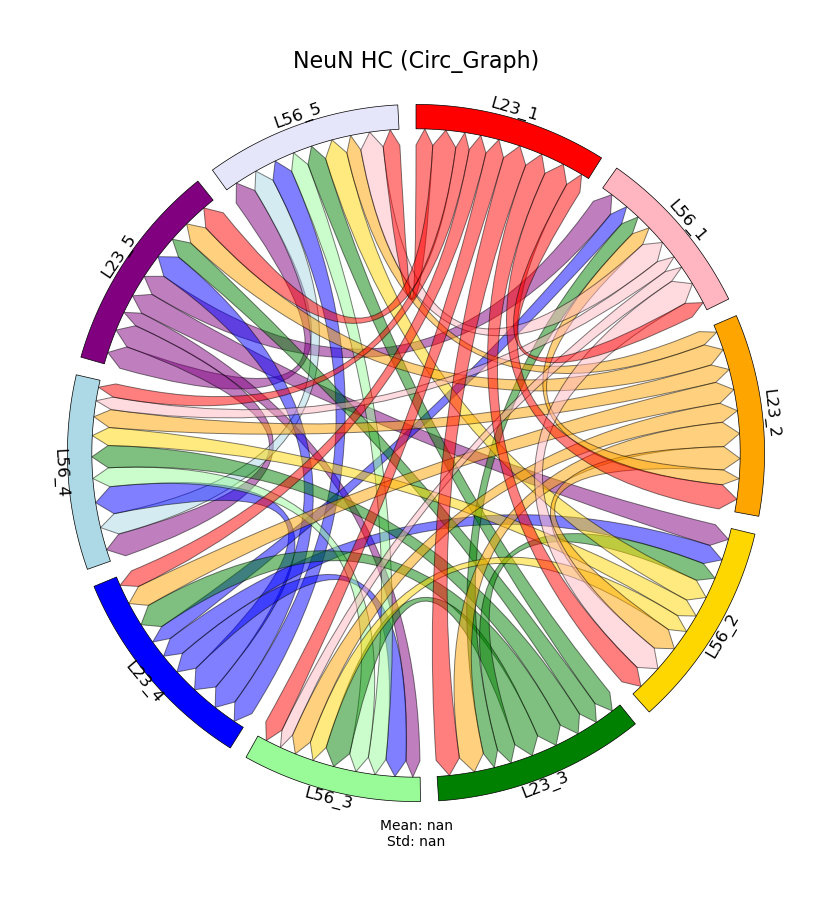

In [96]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

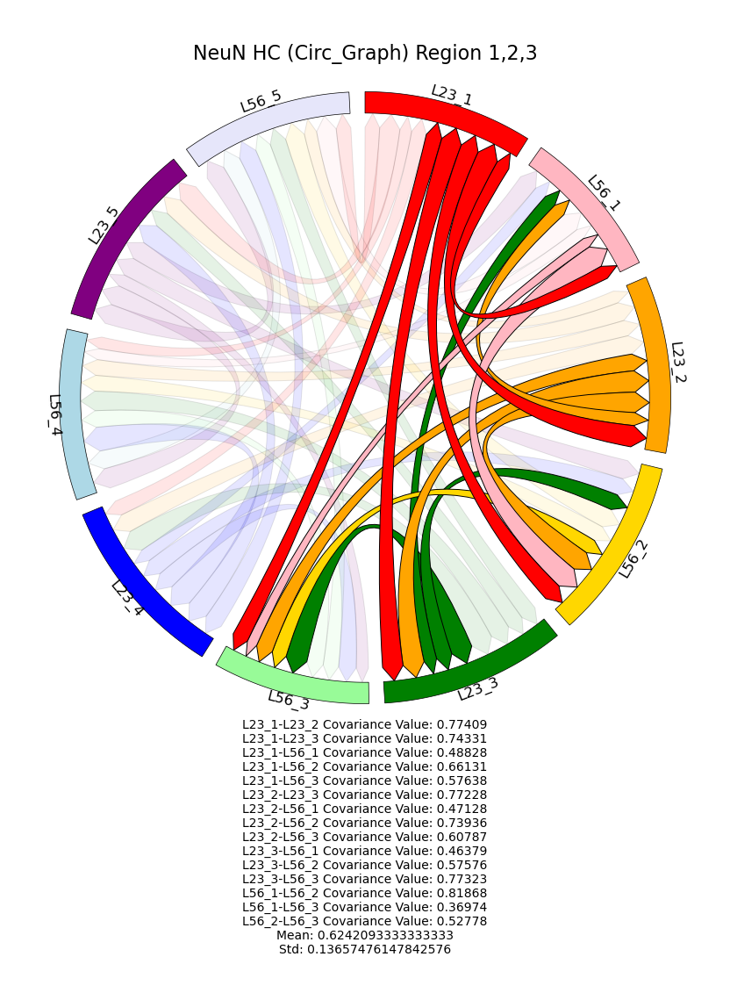

In [97]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track, 
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

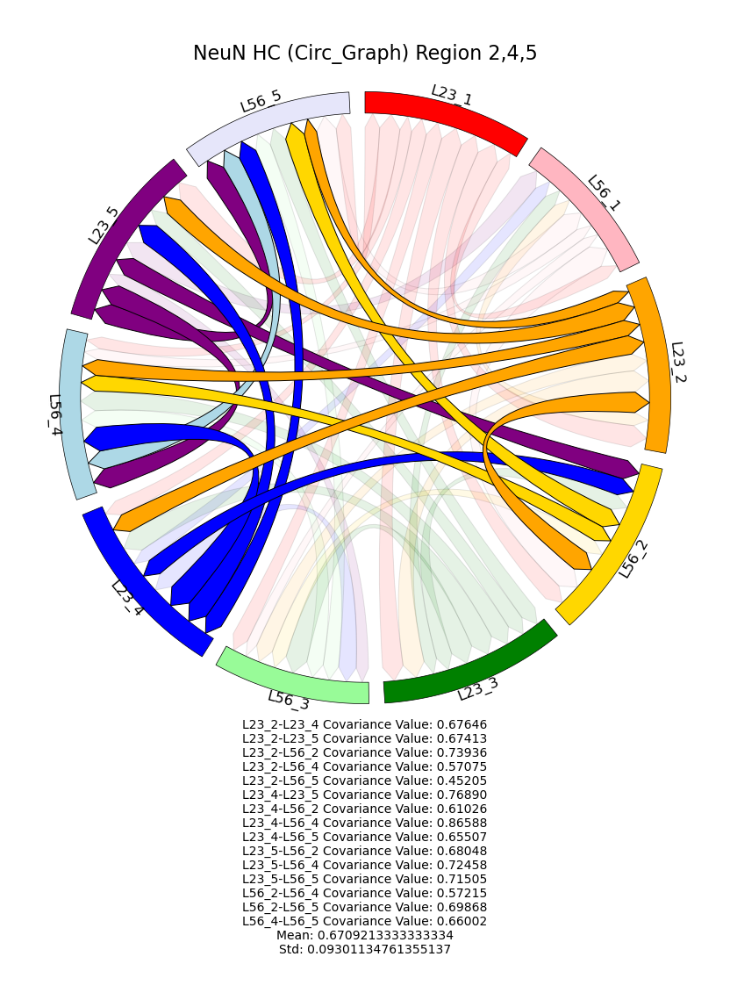

In [98]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track, 
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

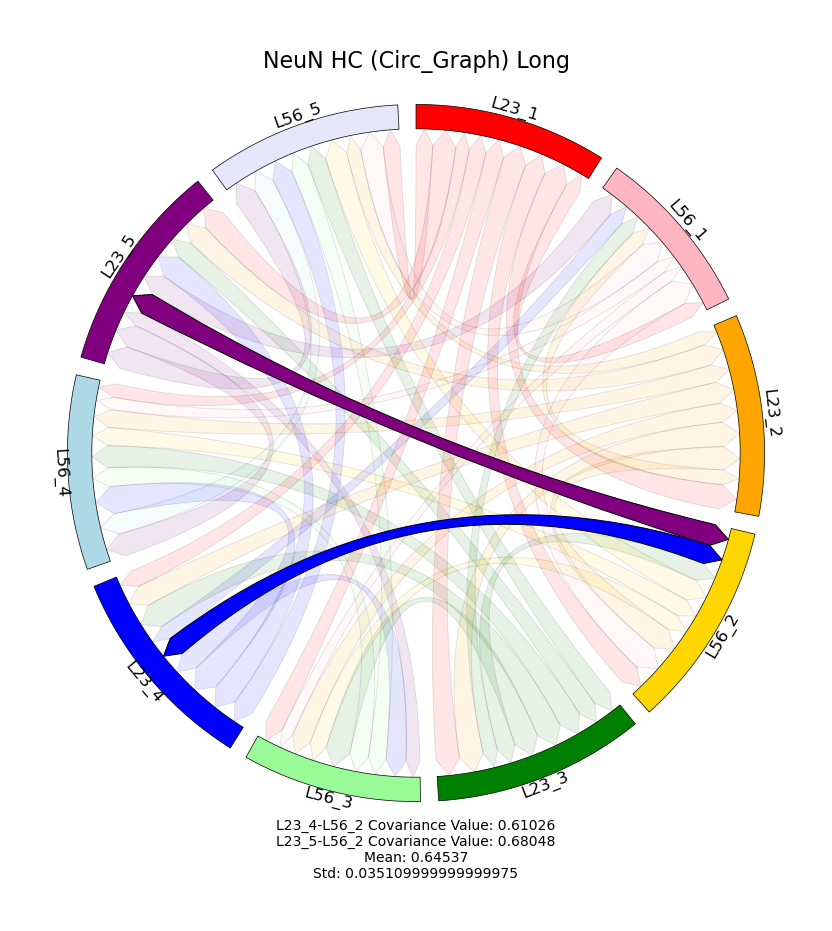

In [99]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long = True)

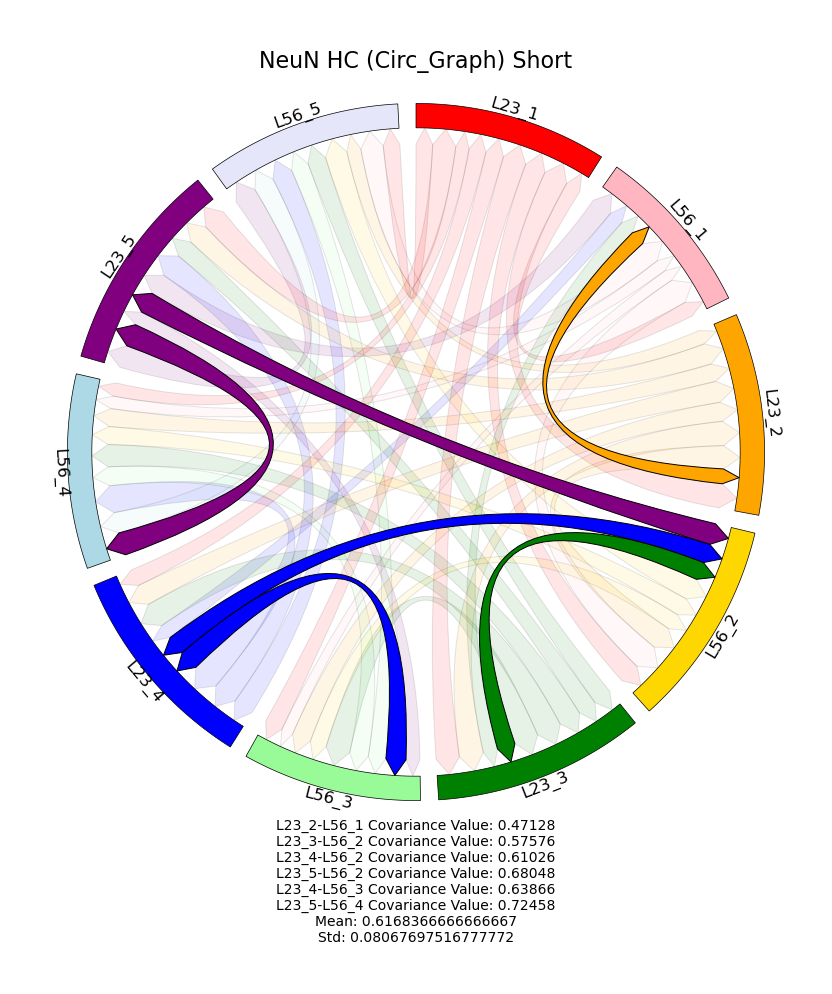

In [100]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short = True)

## Tau

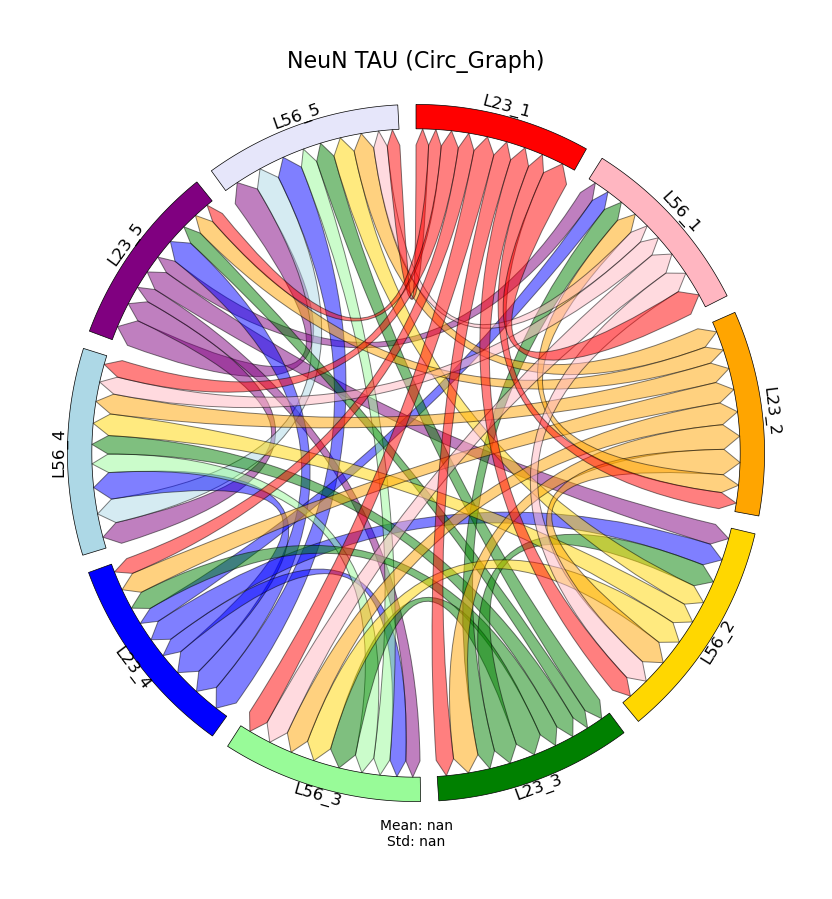

In [101]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

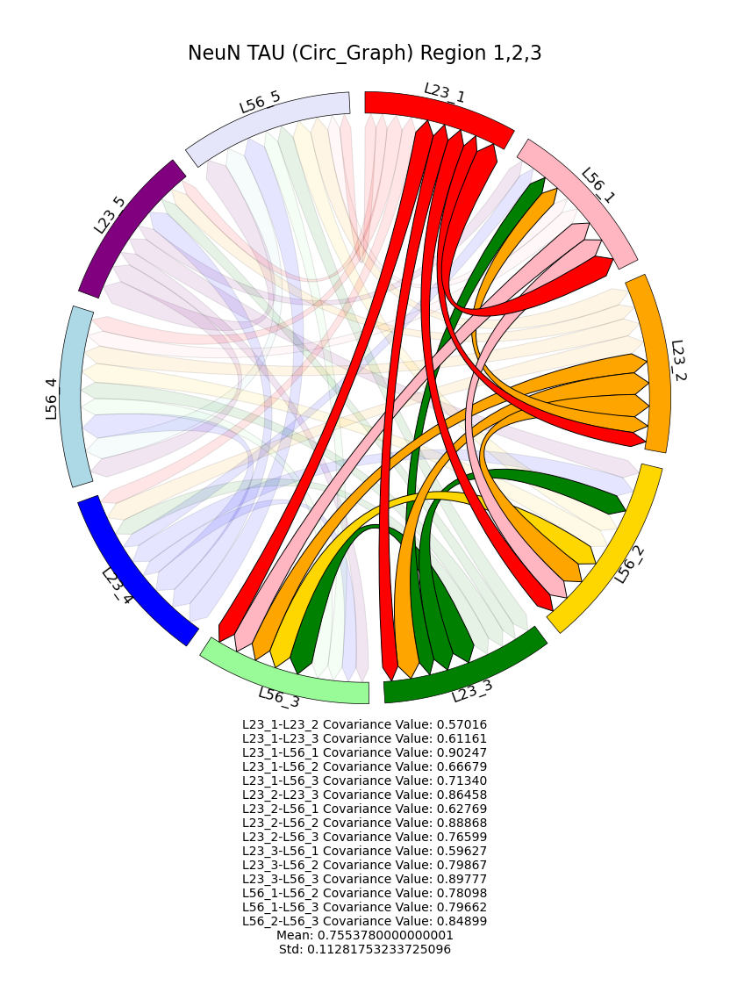

In [102]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track, 
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

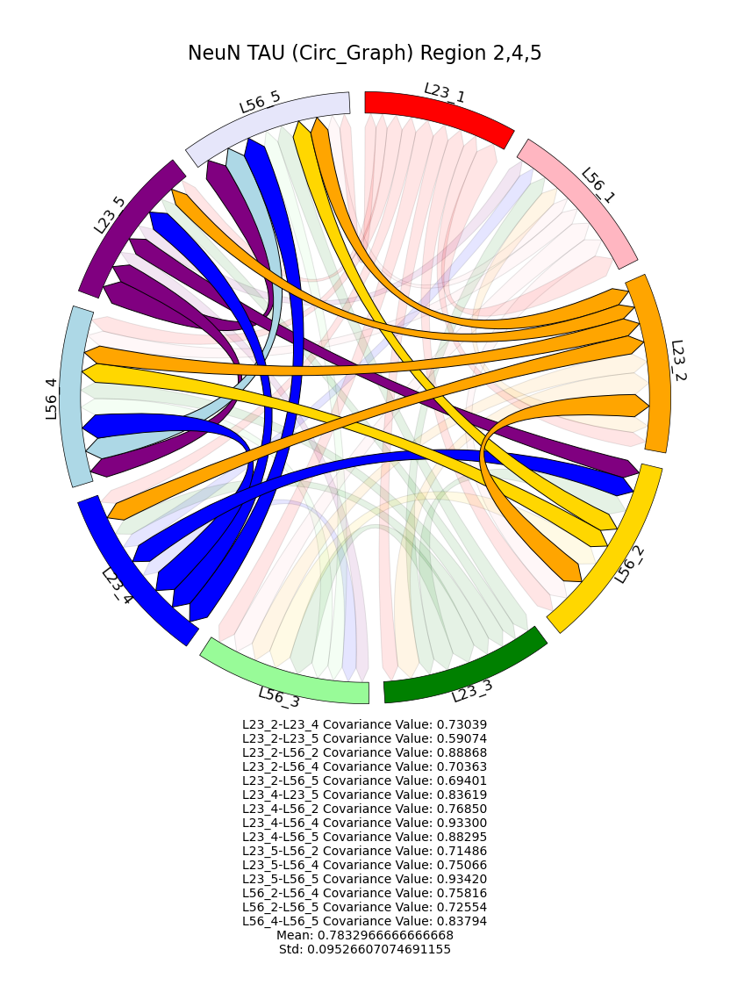

In [103]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track, 
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

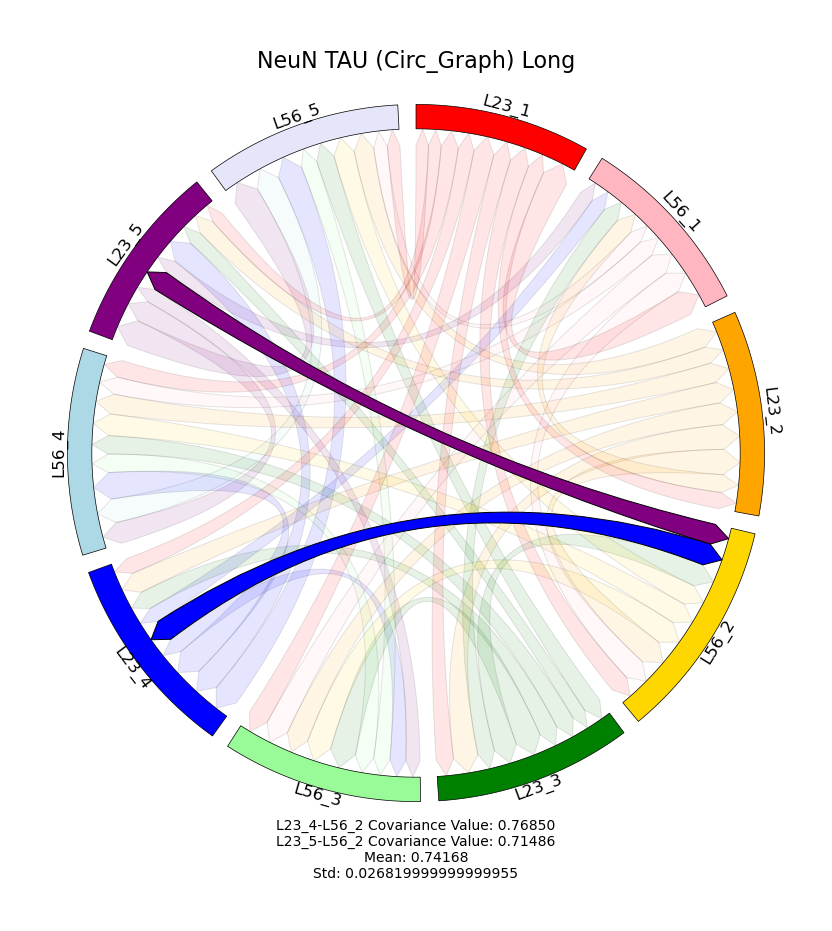

In [104]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long=True)

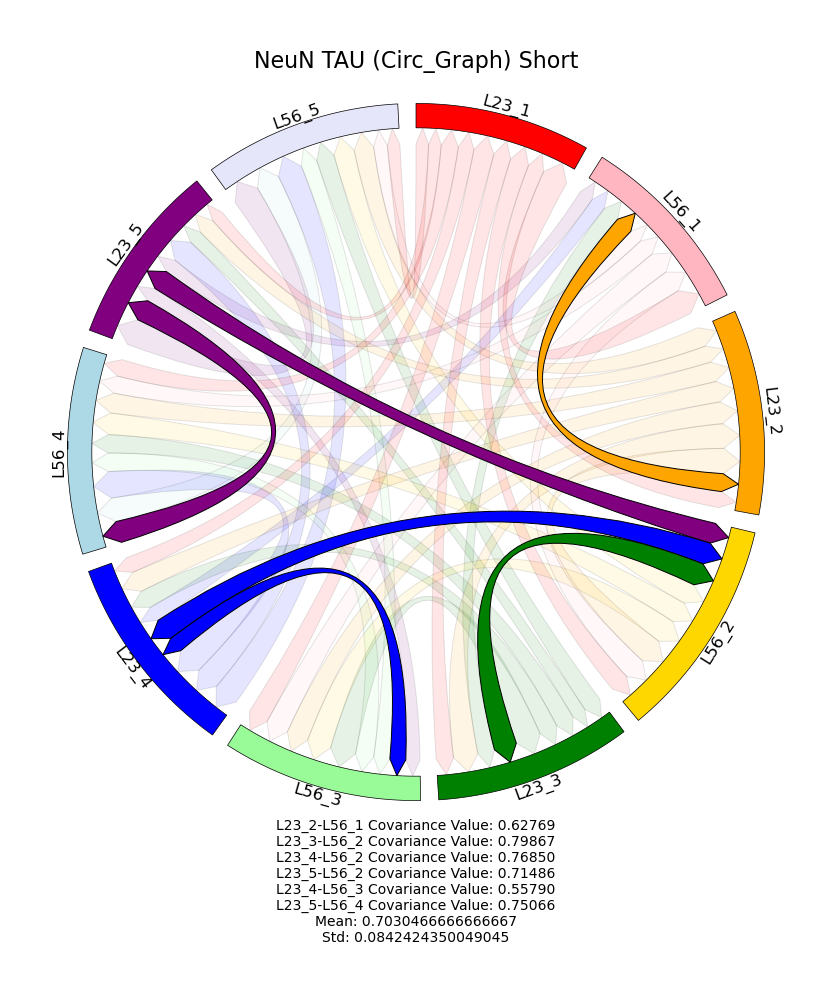

In [105]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short=True)

## TDP

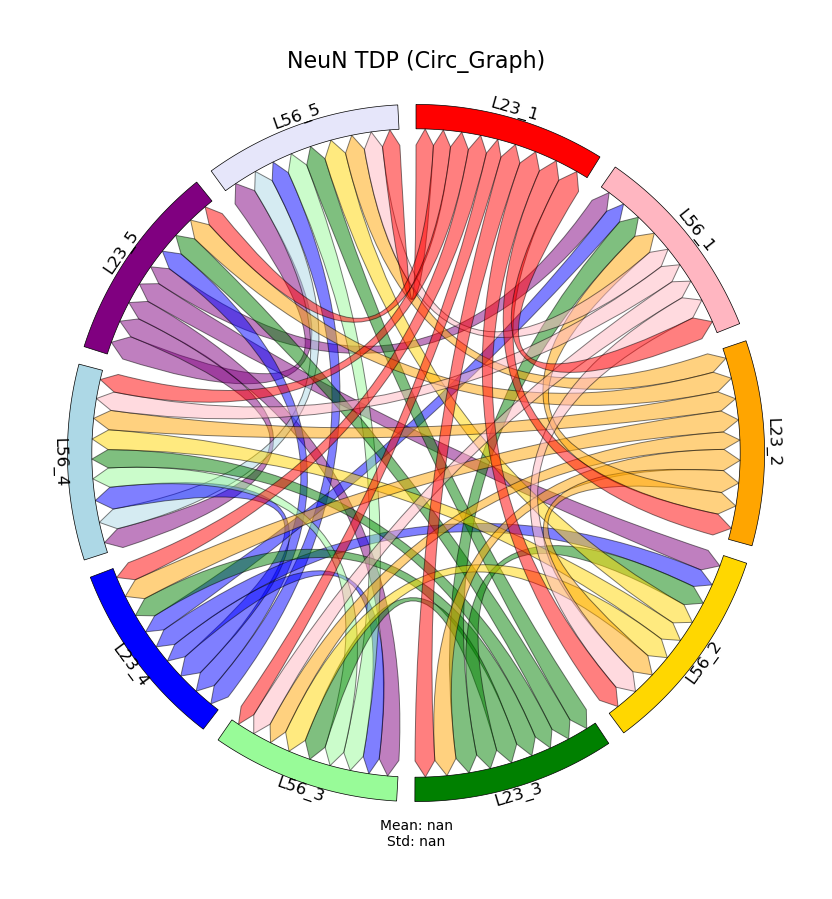

In [106]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

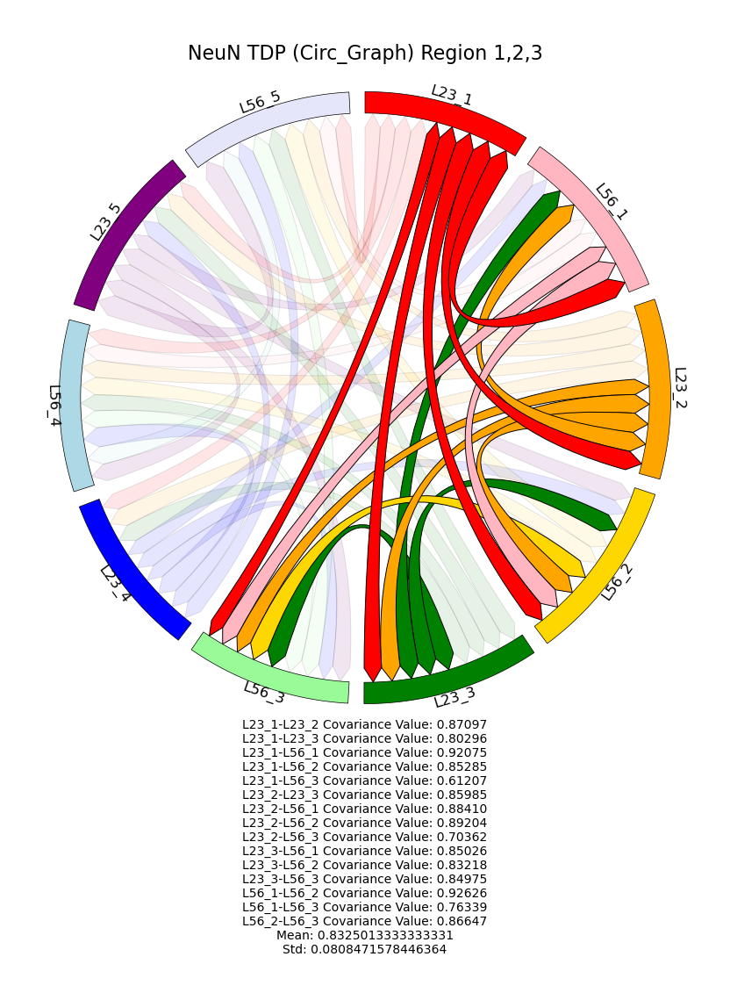

In [107]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track,
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

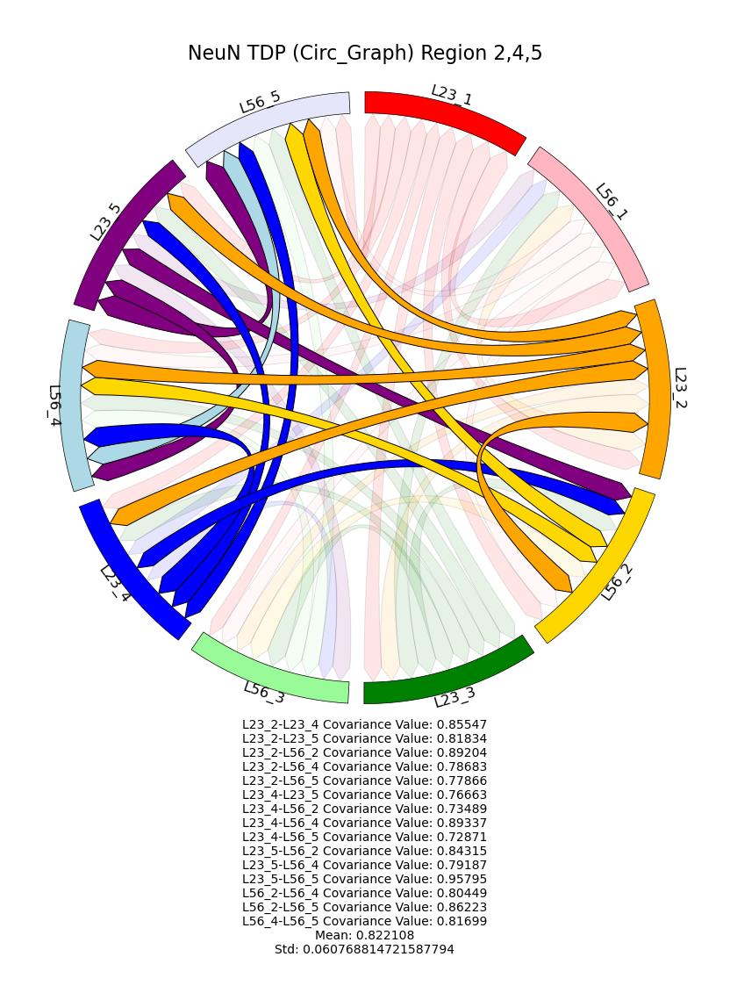

In [108]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track,
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

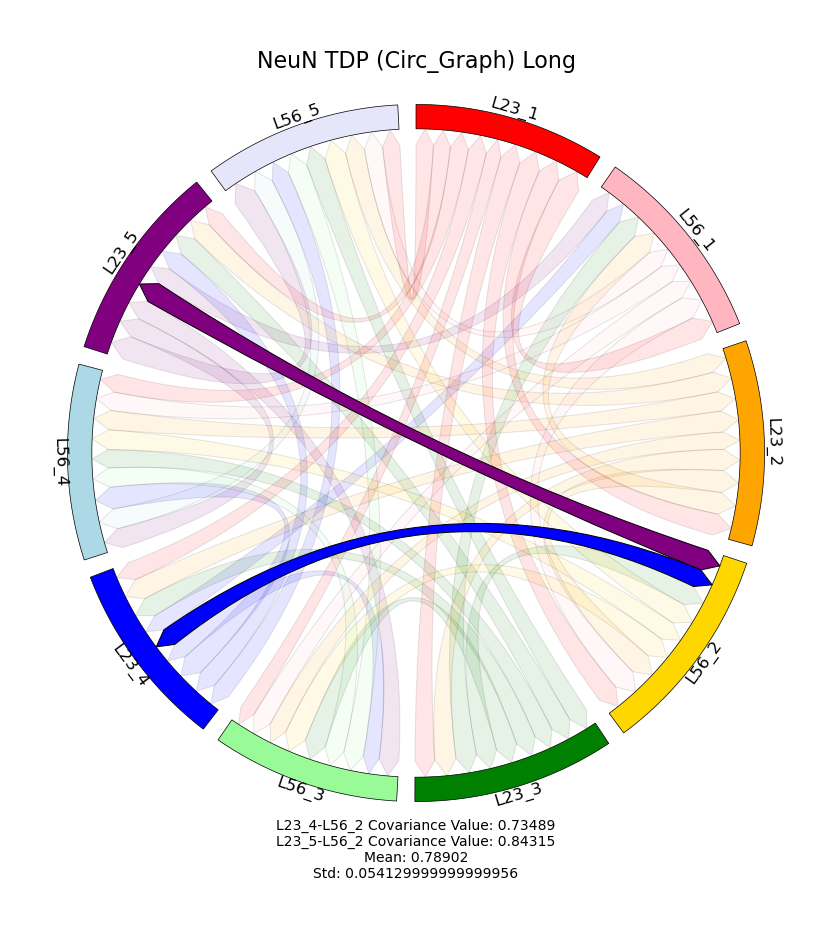

In [109]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long=True)

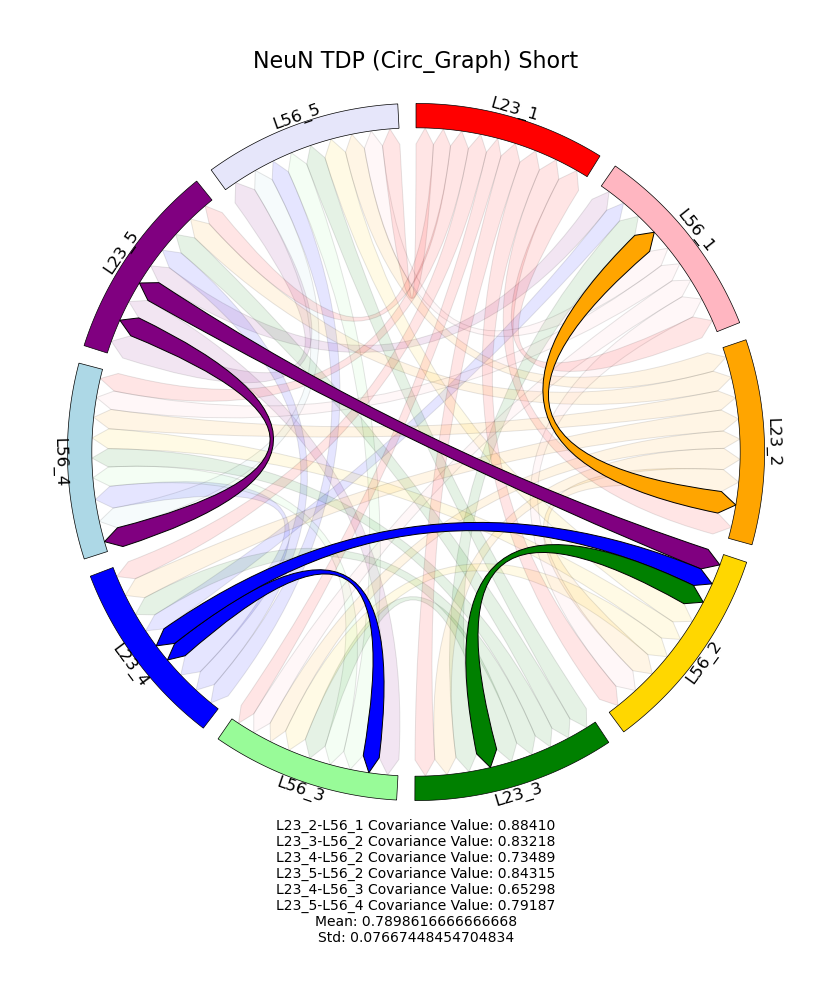

In [110]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short=True)

## HC > Tau

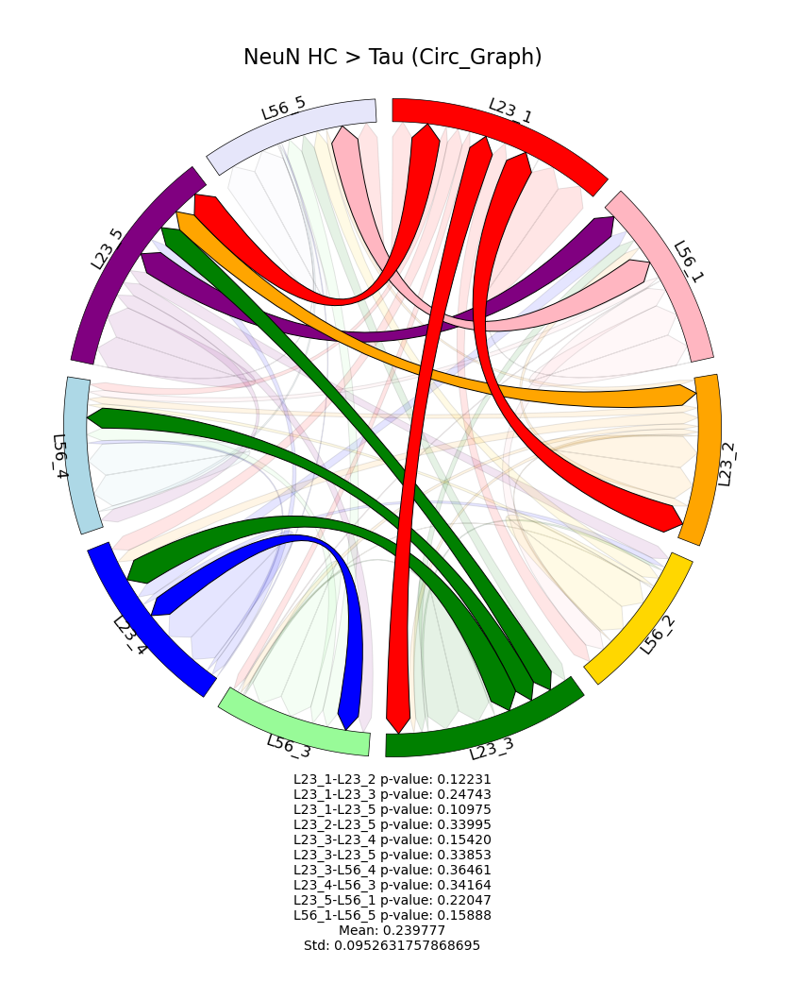

In [111]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

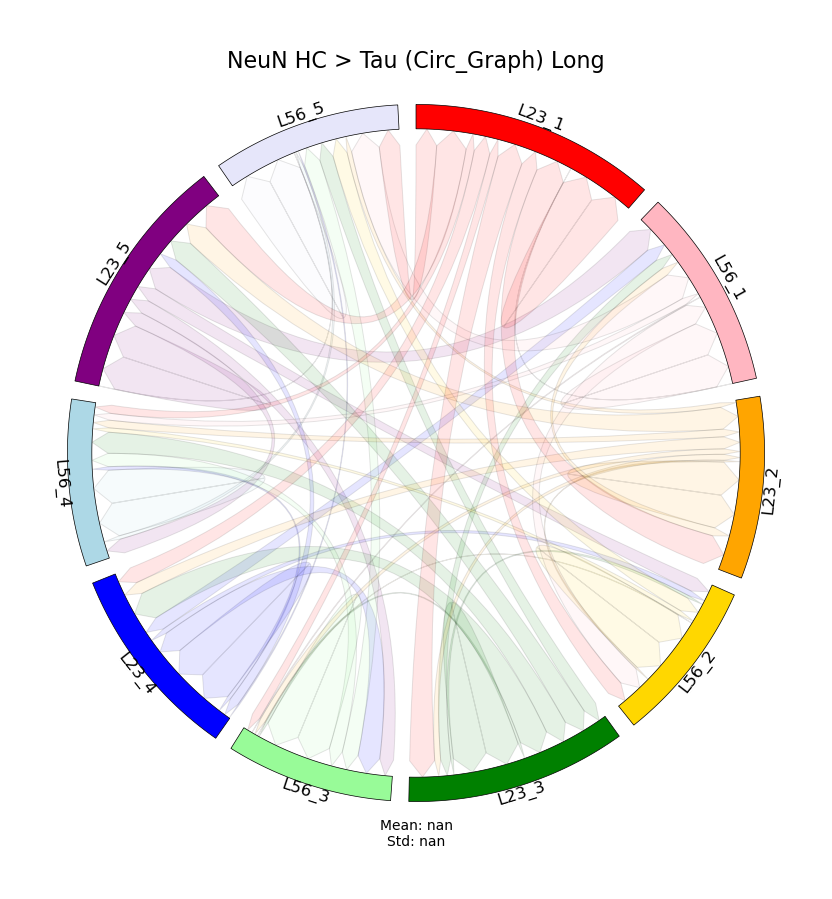

In [112]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

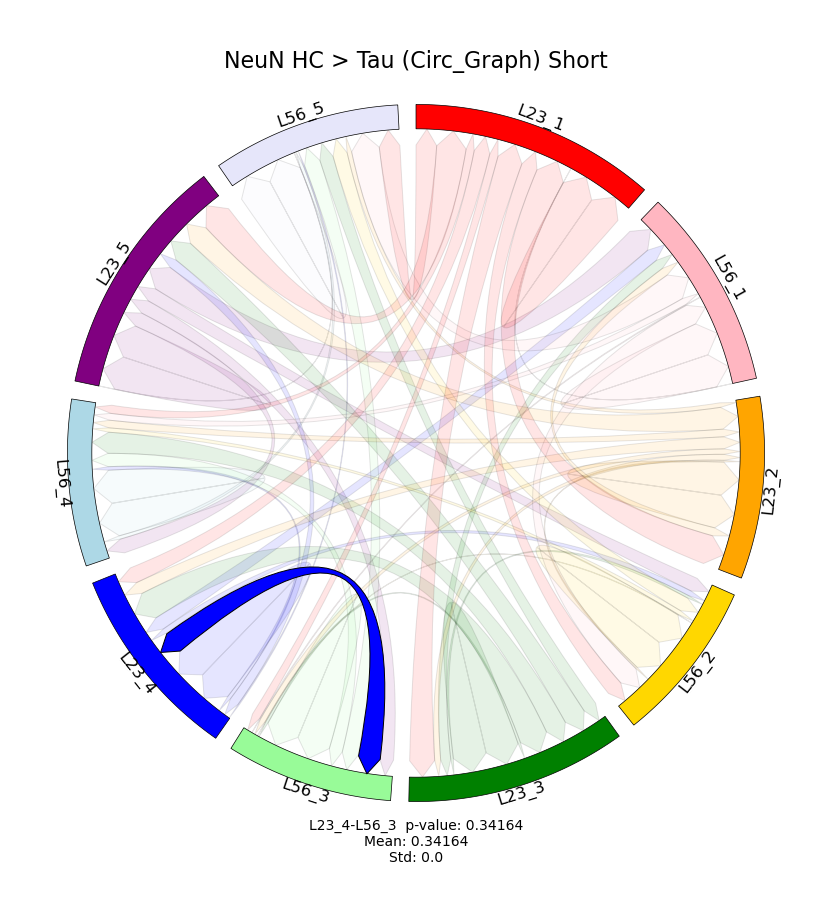

In [113]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## Tau > HC

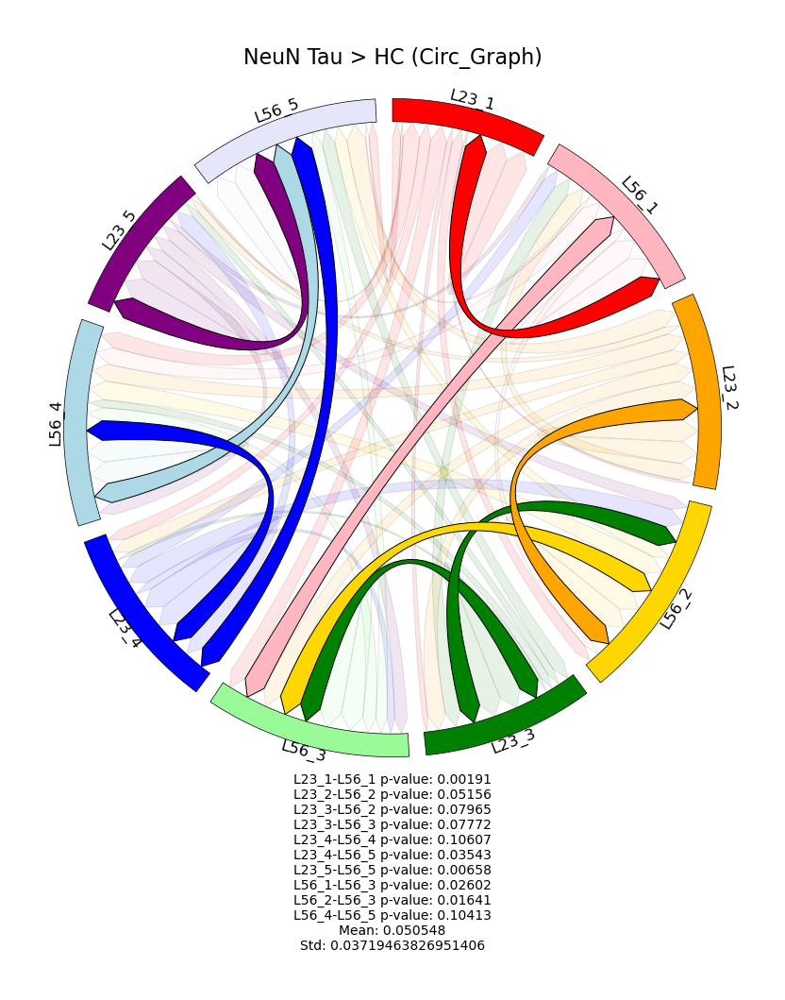

In [114]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

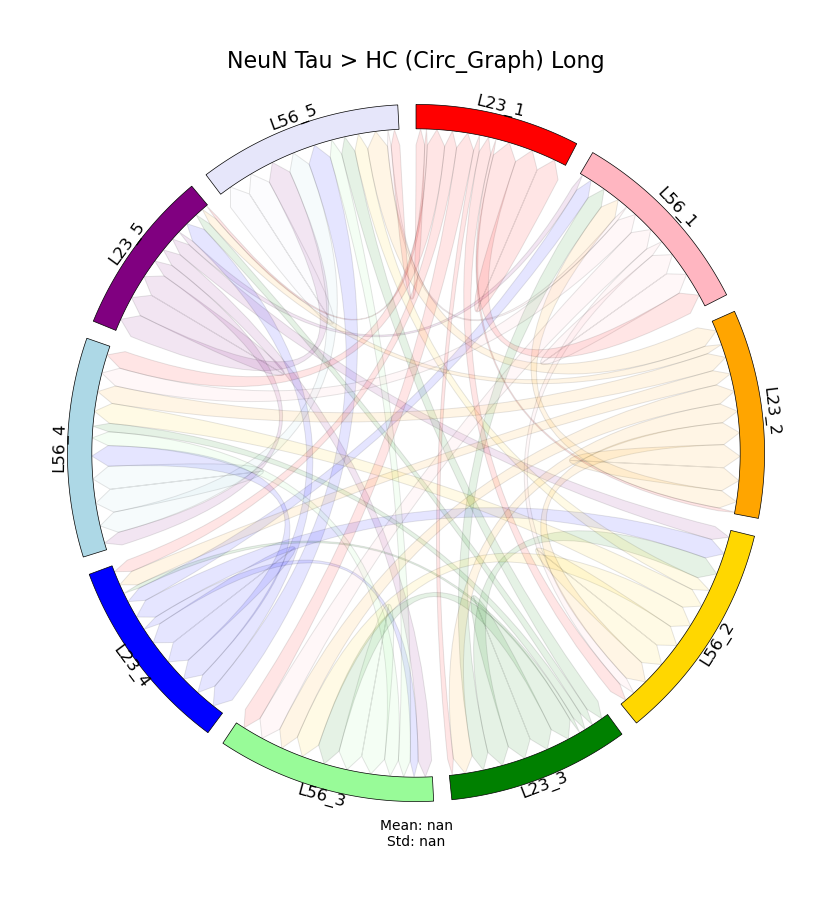

In [115]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

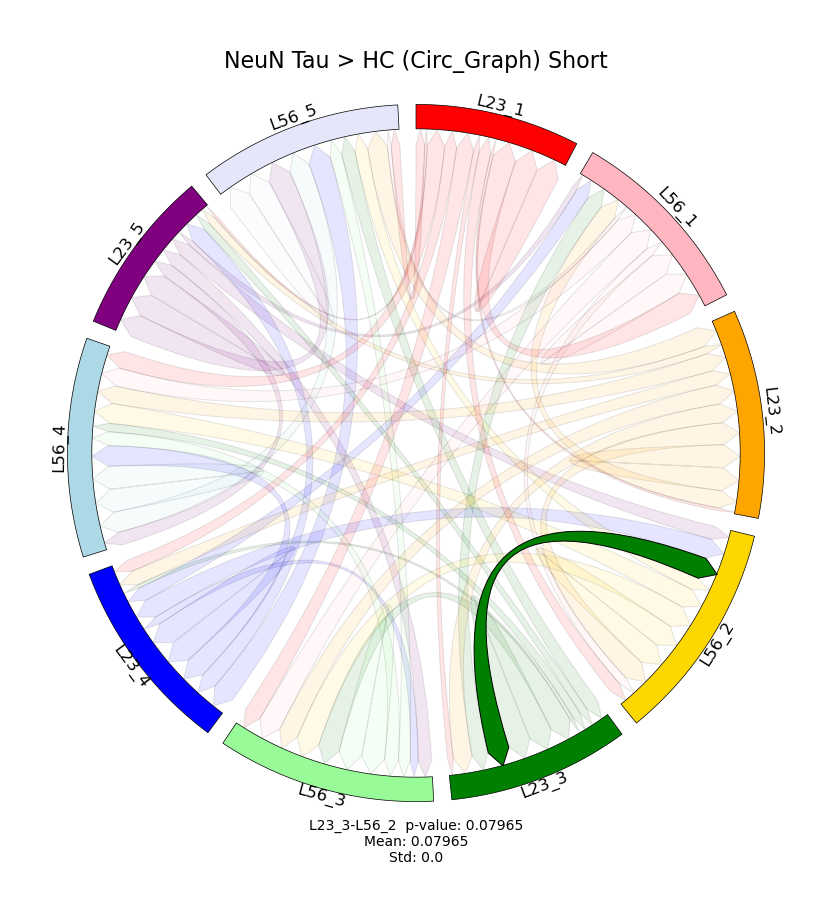

In [116]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## HC > TDP

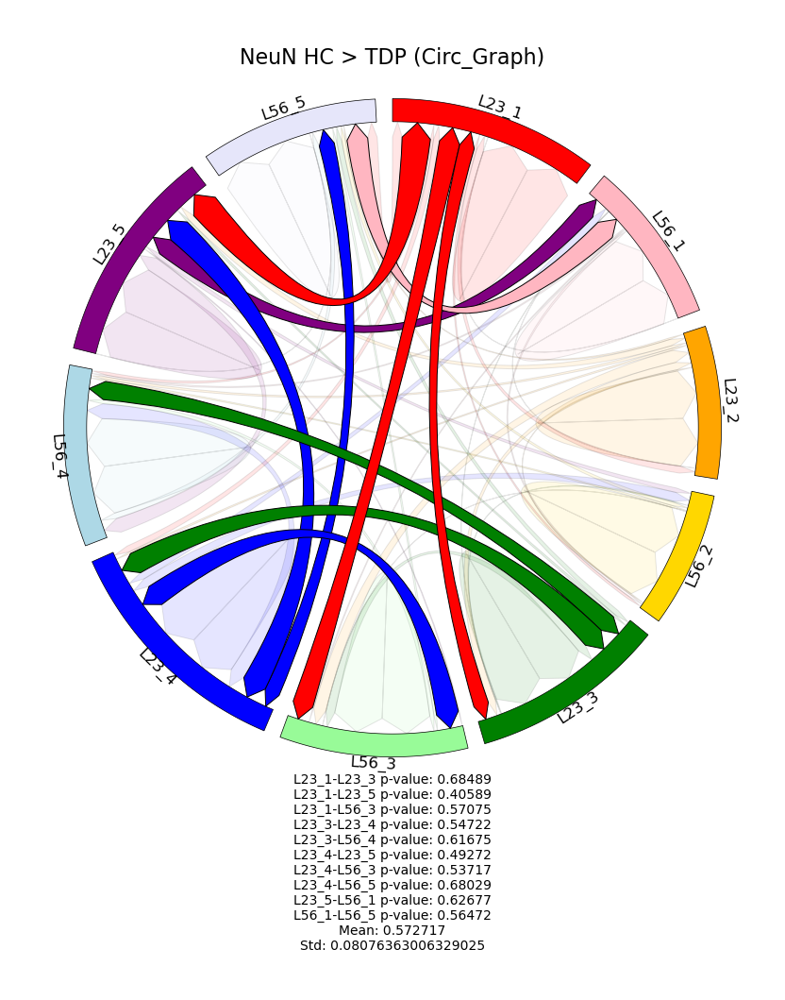

In [117]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

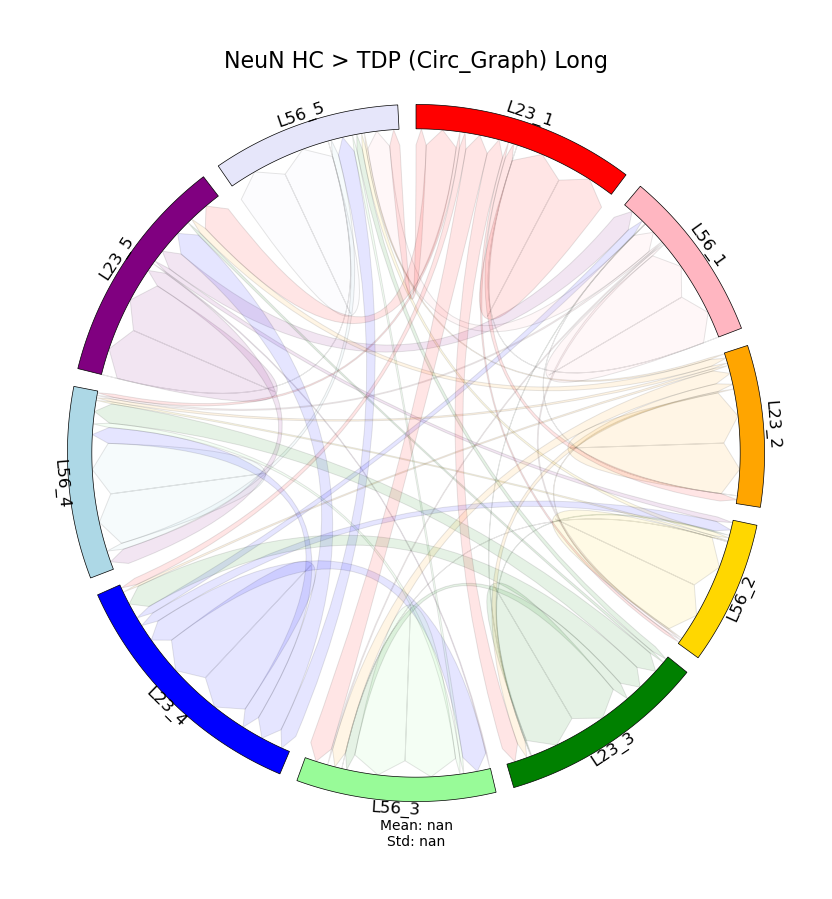

In [118]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

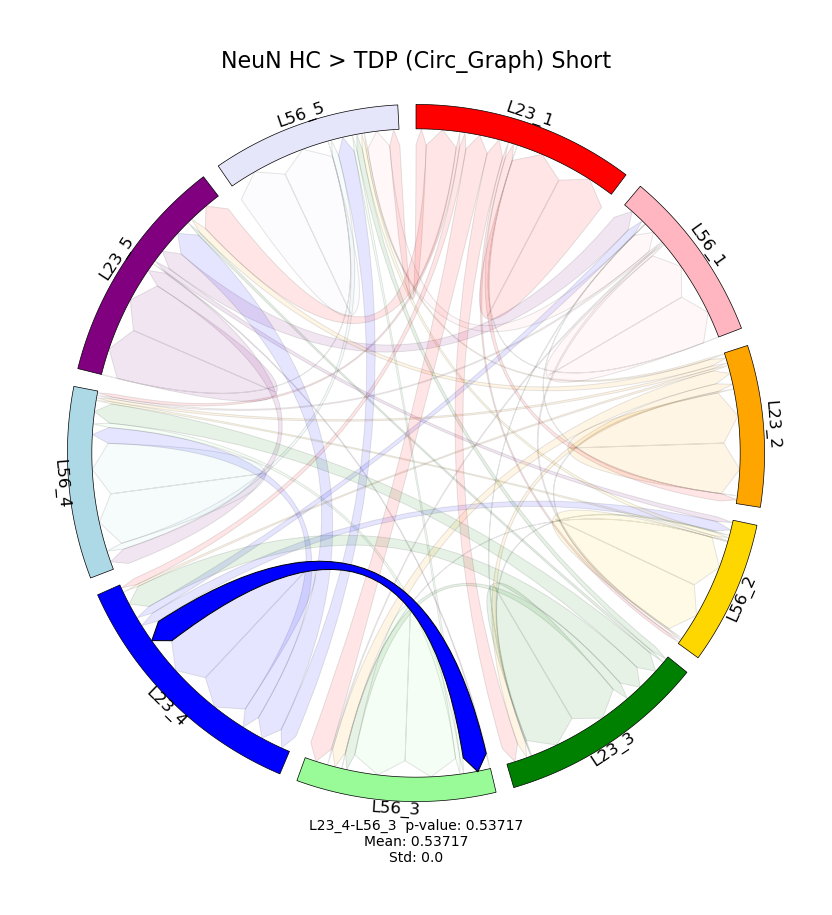

In [119]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## TDP > HC

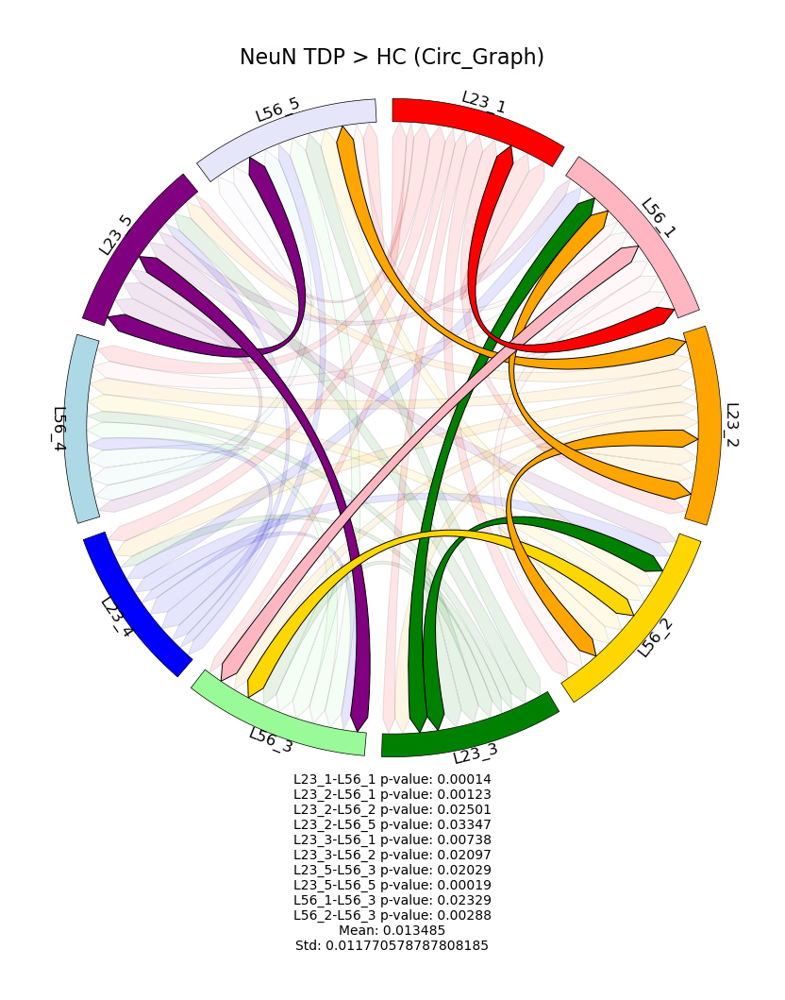

In [120]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

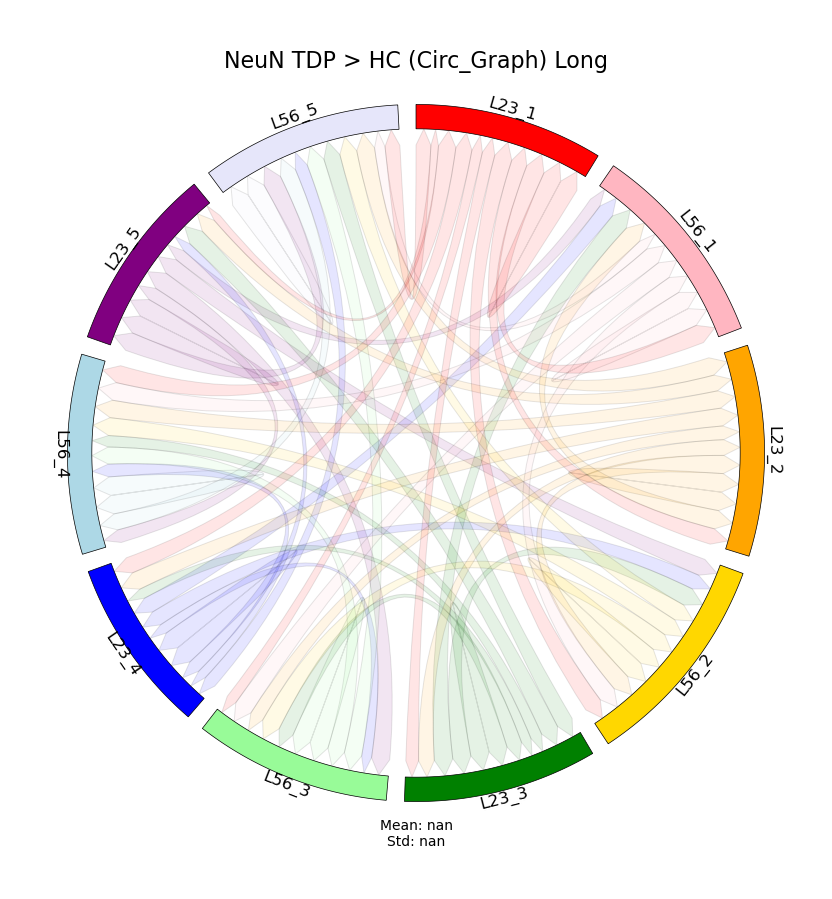

In [121]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

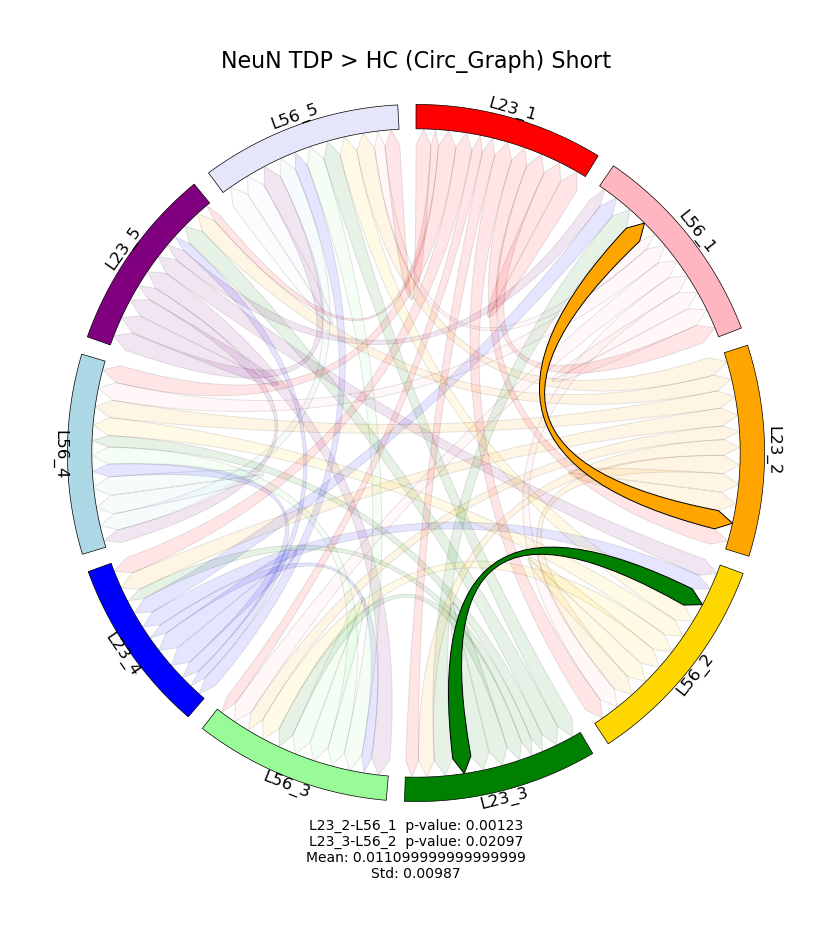

In [122]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## Tau > TDP

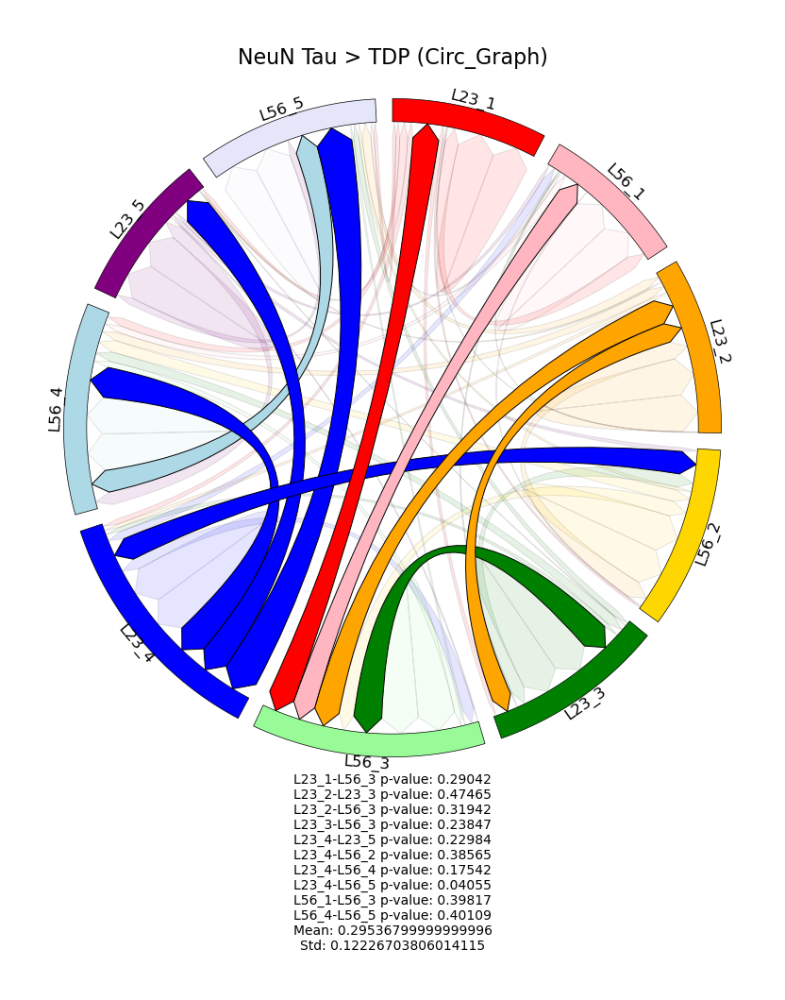

In [123]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

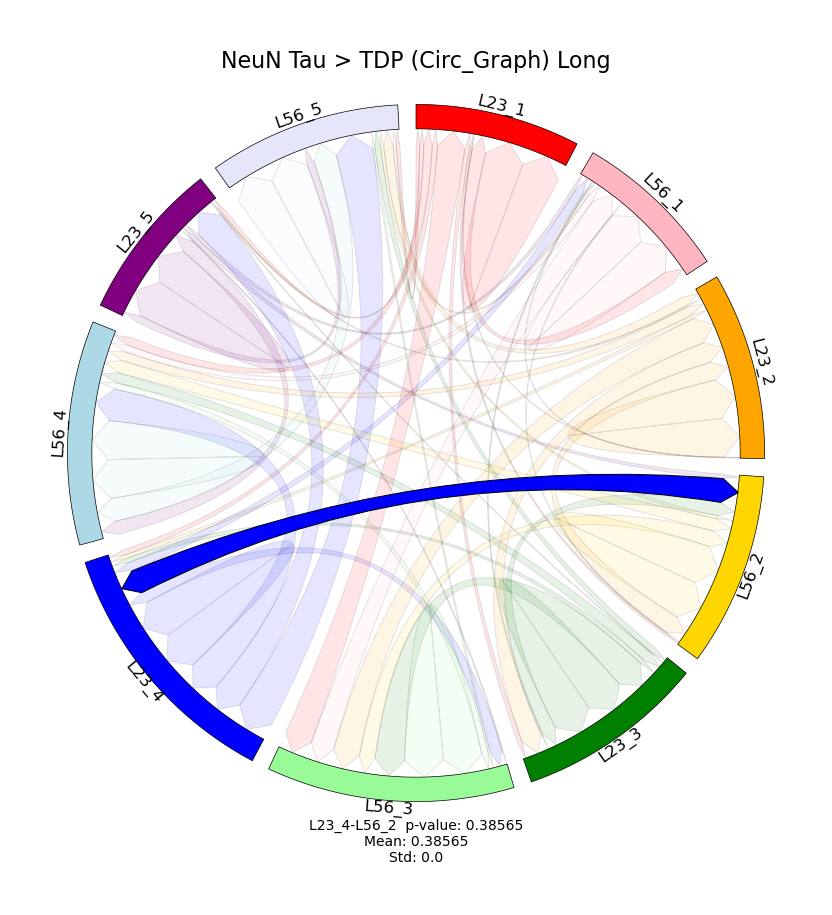

In [124]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

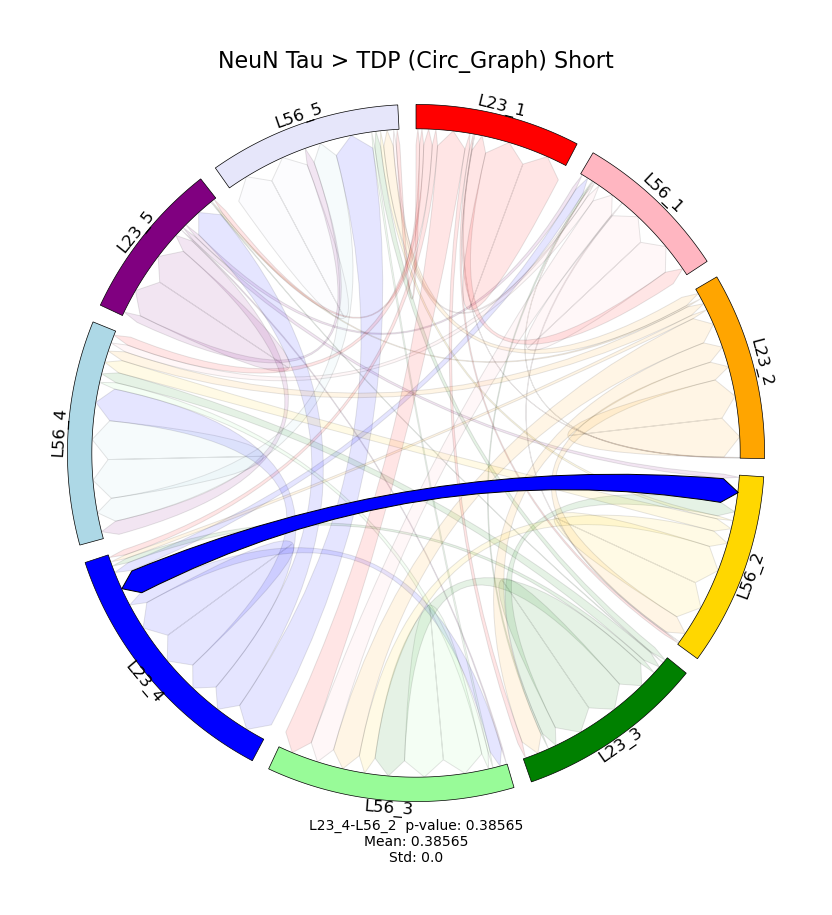

In [125]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## TDP > Tau

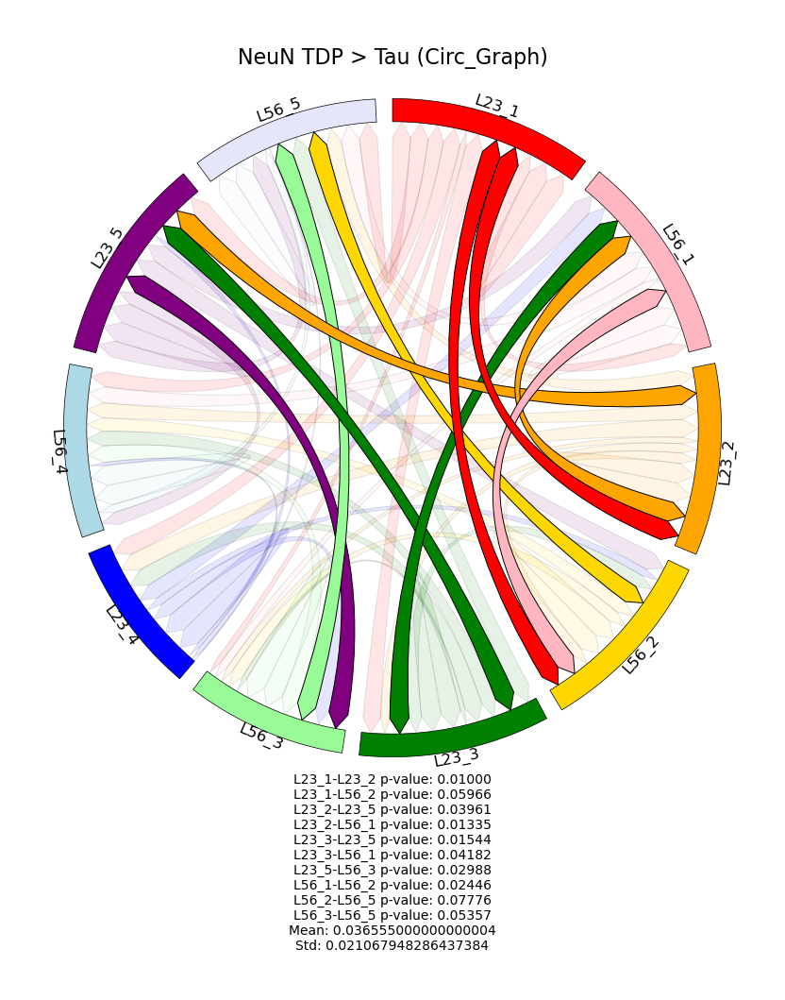

In [126]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

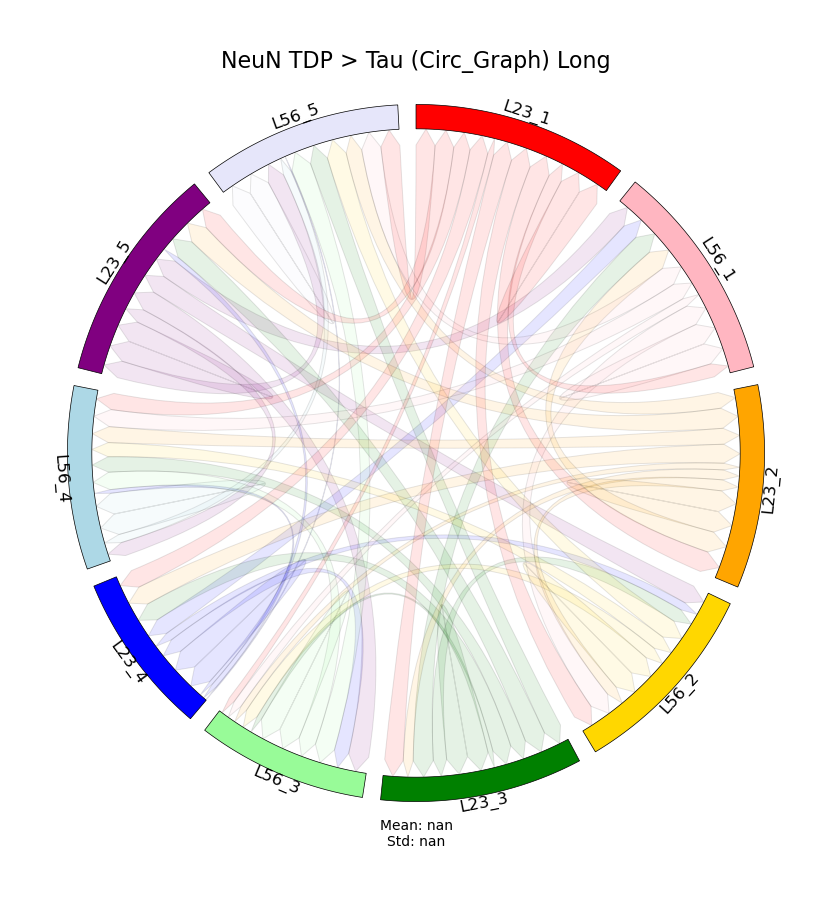

In [127]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

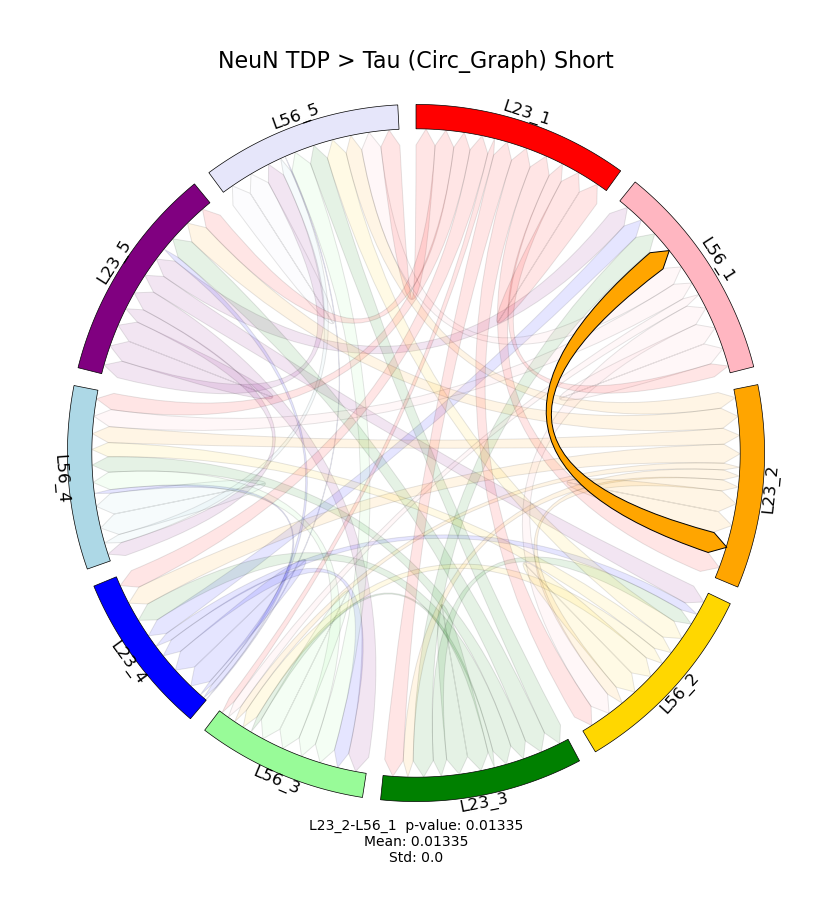

In [128]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

# Draw Graph Networks (NeuN) W Score

### Define Variables

In [129]:
# Variable setting
neuron_type = "NeuN(W Score)"

cov_dict = cov_NeuN_dict_w
data_label = NeuN_Labels

## HC

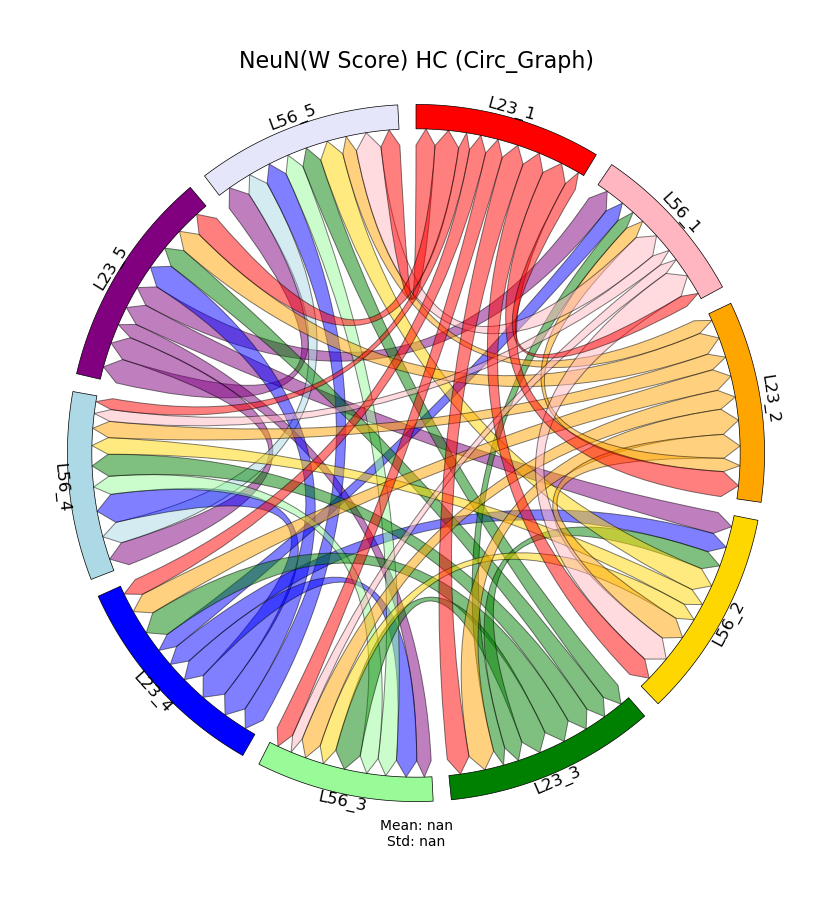

In [130]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

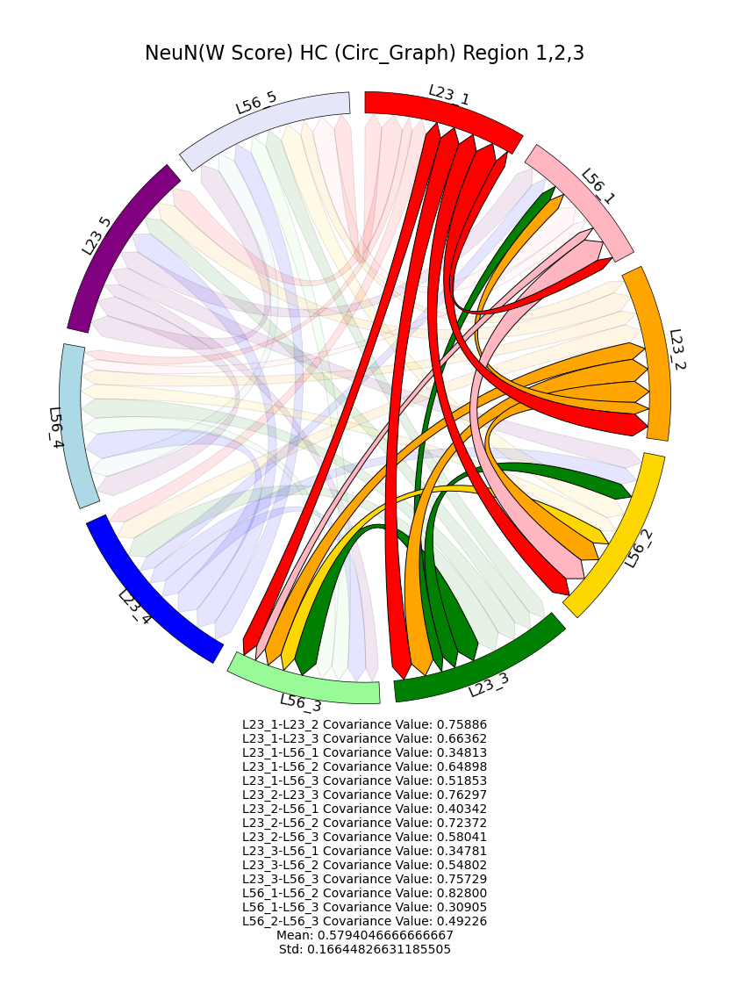

In [131]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track, 
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

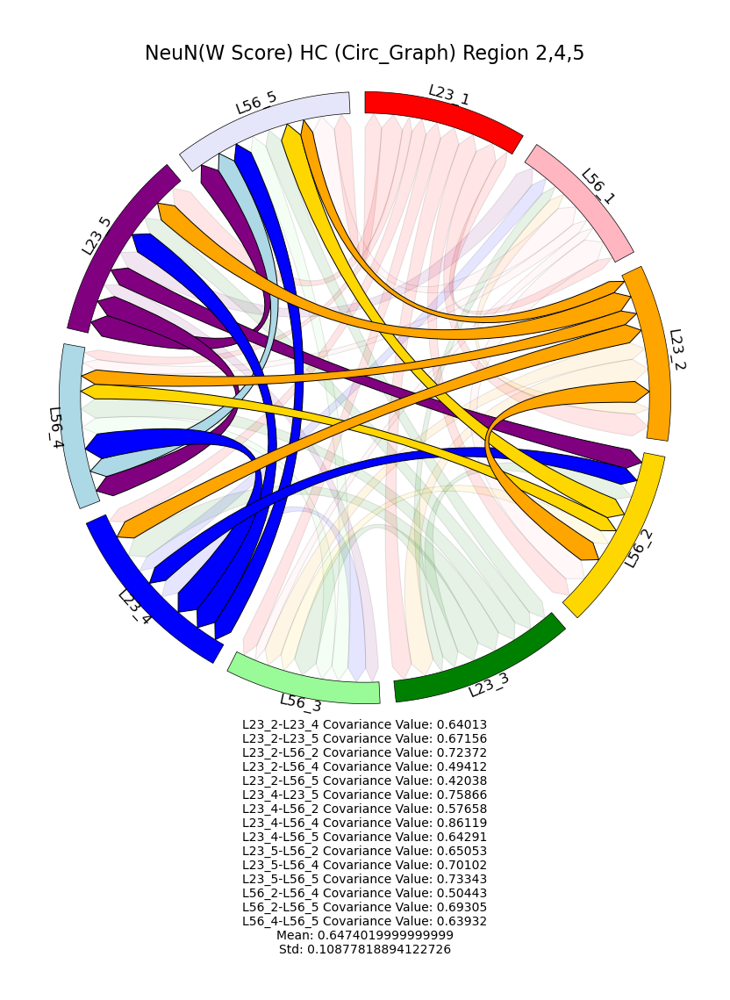

In [132]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track, 
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

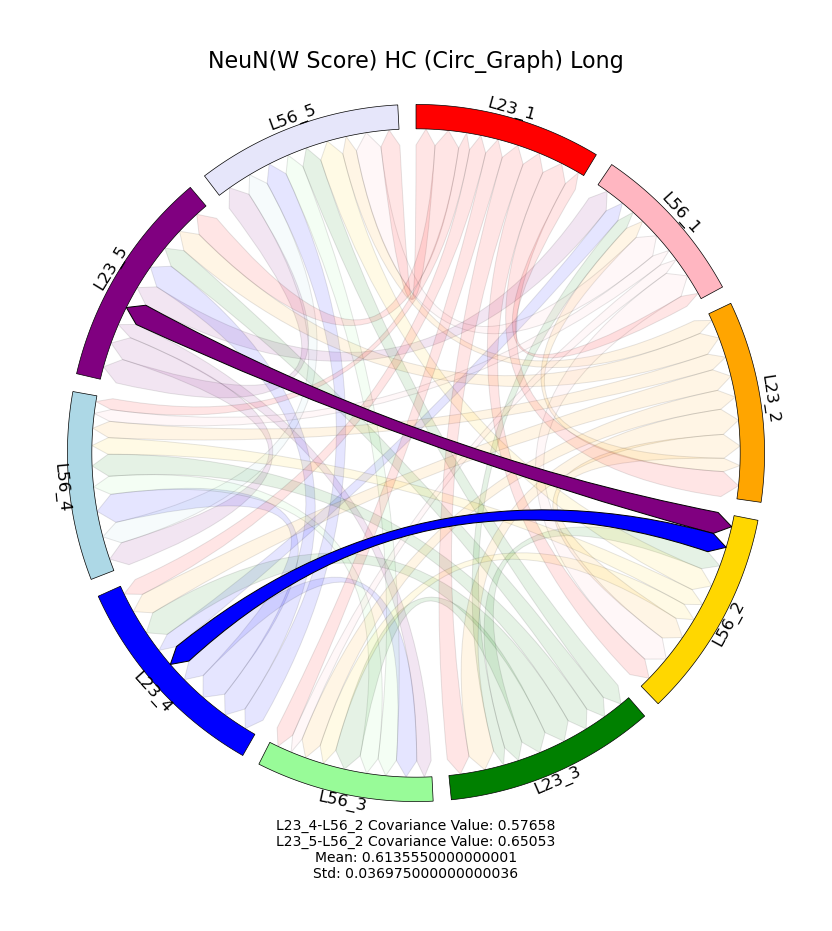

In [133]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long = True)

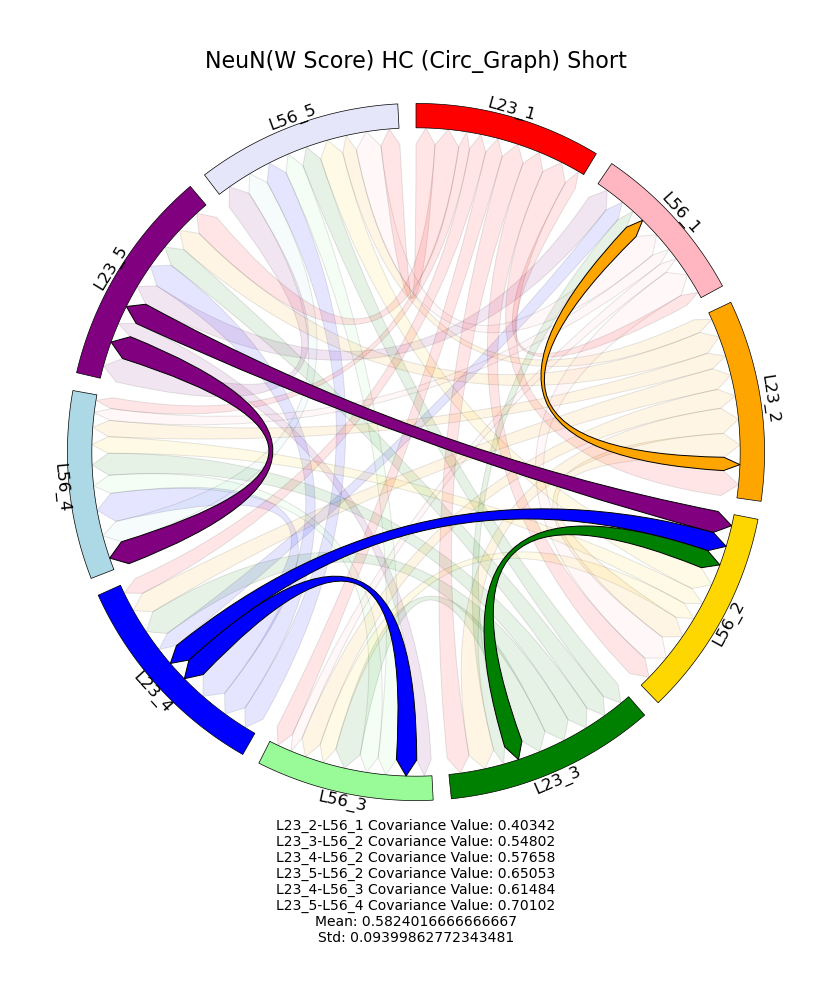

In [134]:
cp.circularPlot(cov_dict['HC'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short = True)

## Tau

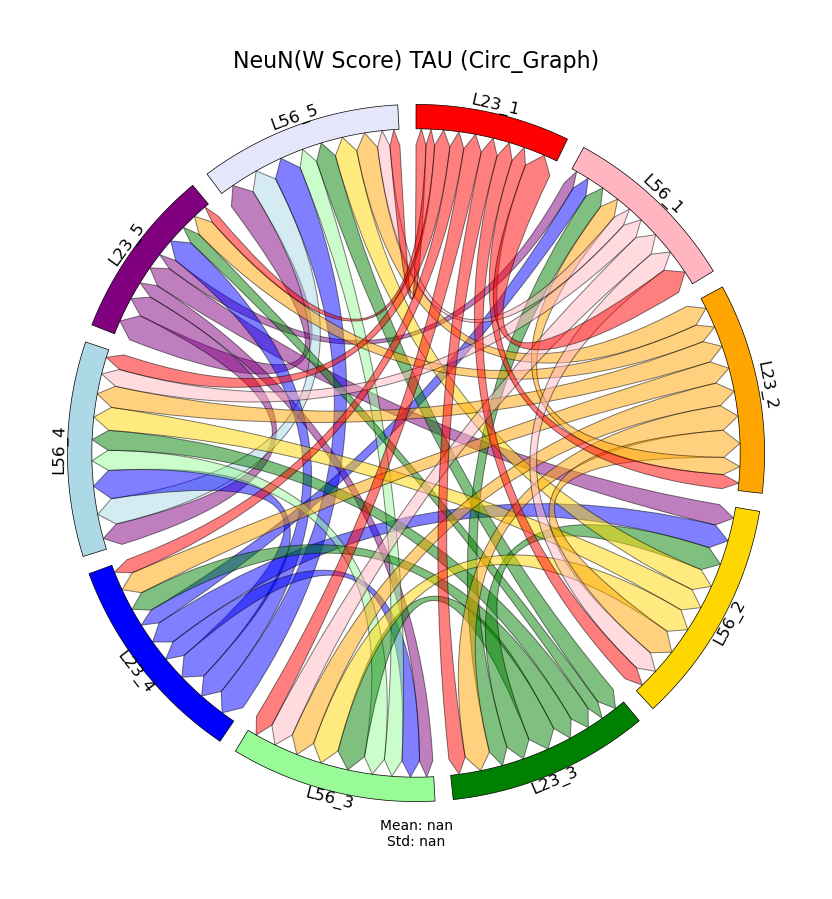

In [135]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

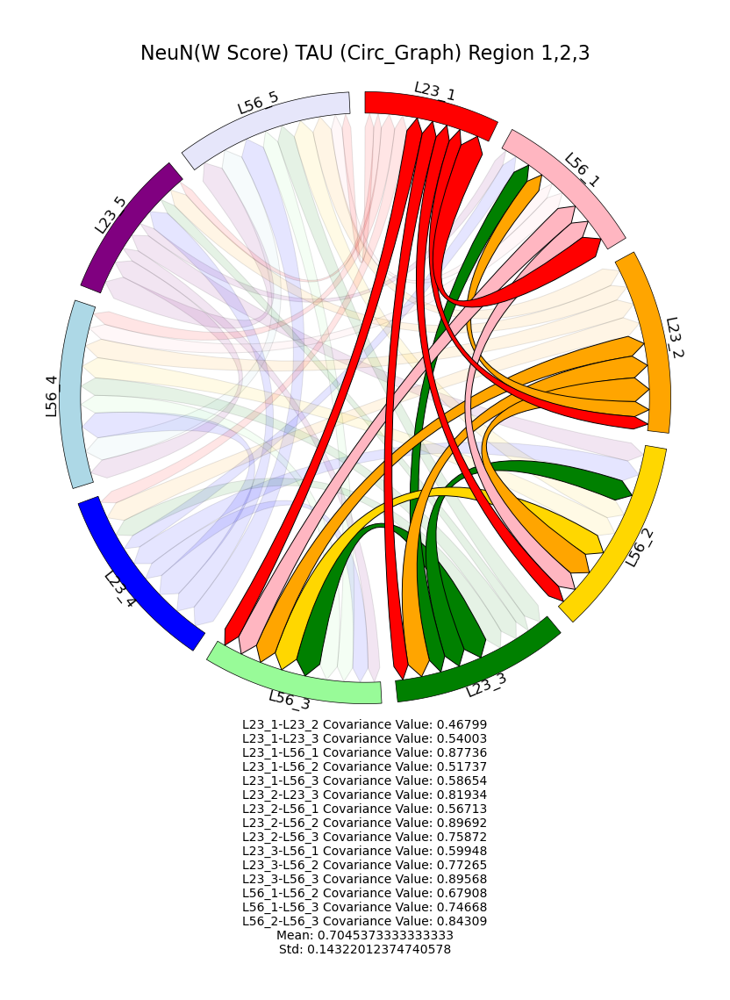

In [136]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track, 
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

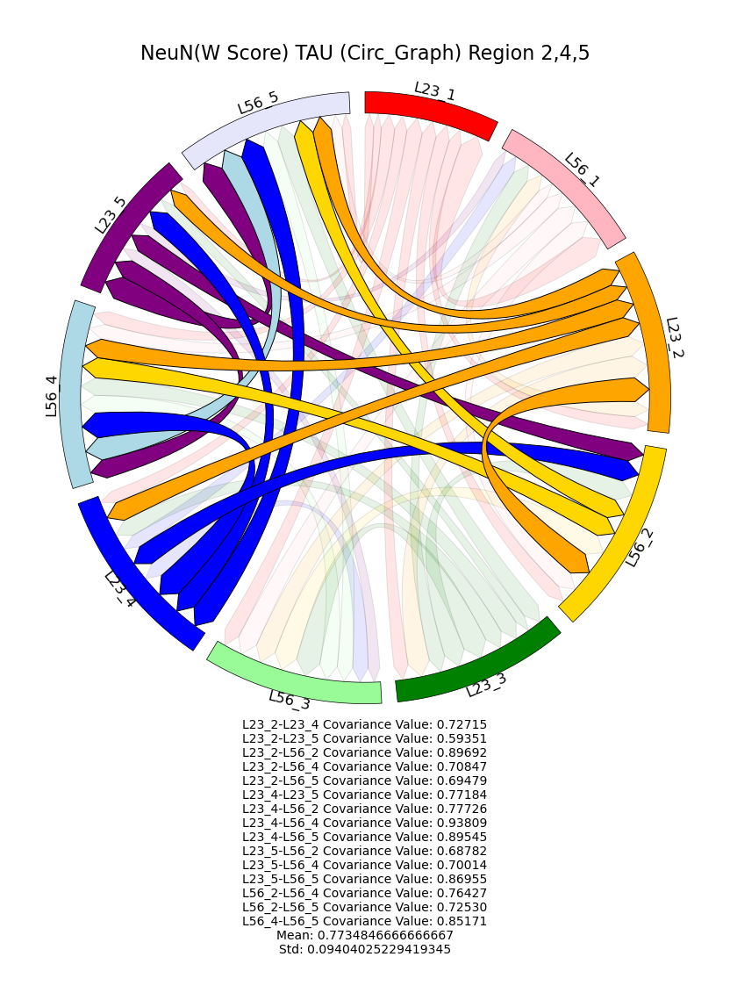

In [137]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track, 
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

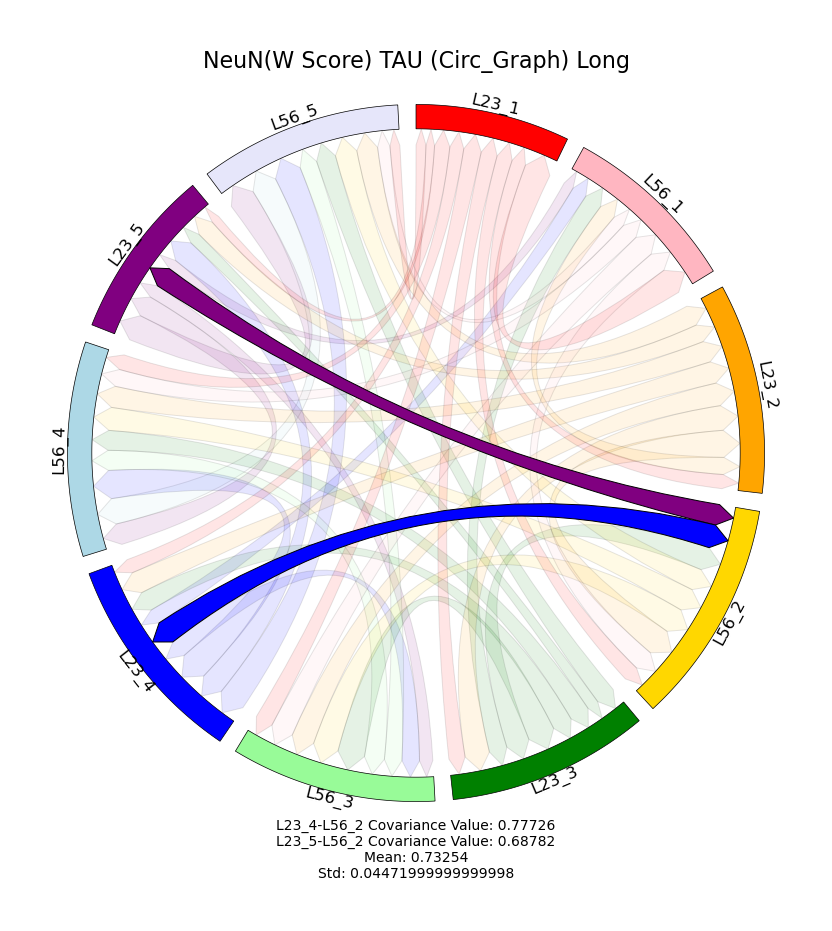

In [138]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long=True)

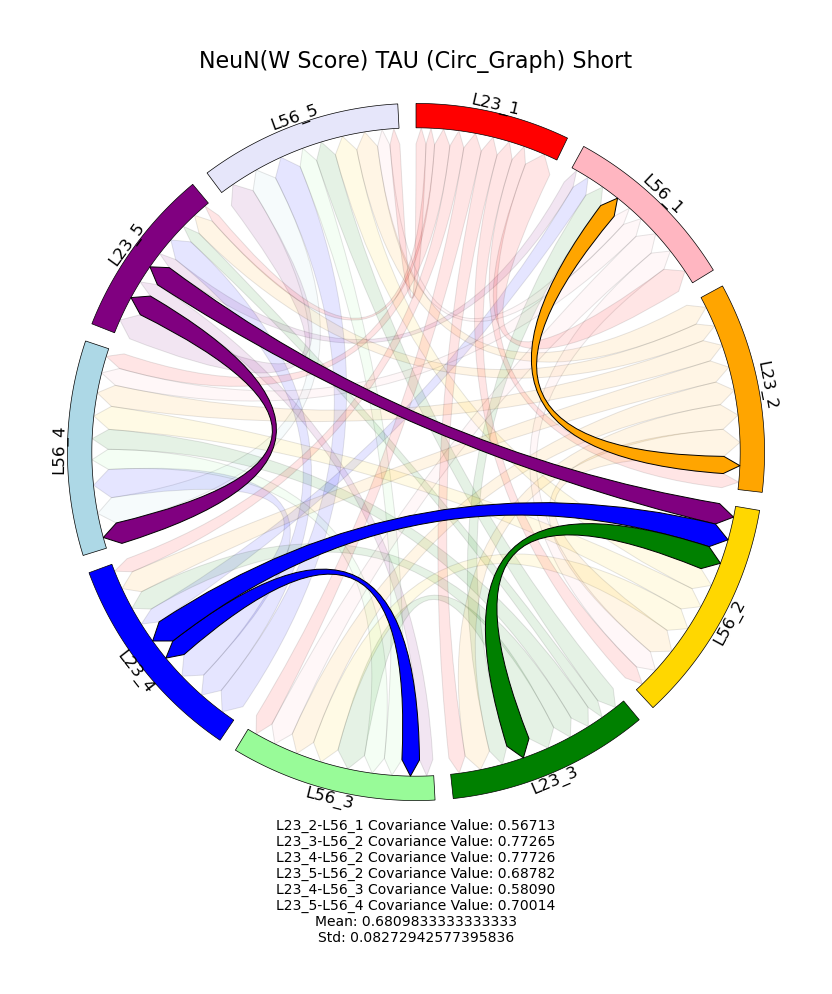

In [139]:
cp.circularPlot(cov_dict['TAU'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TAU (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short=True)

## TDP

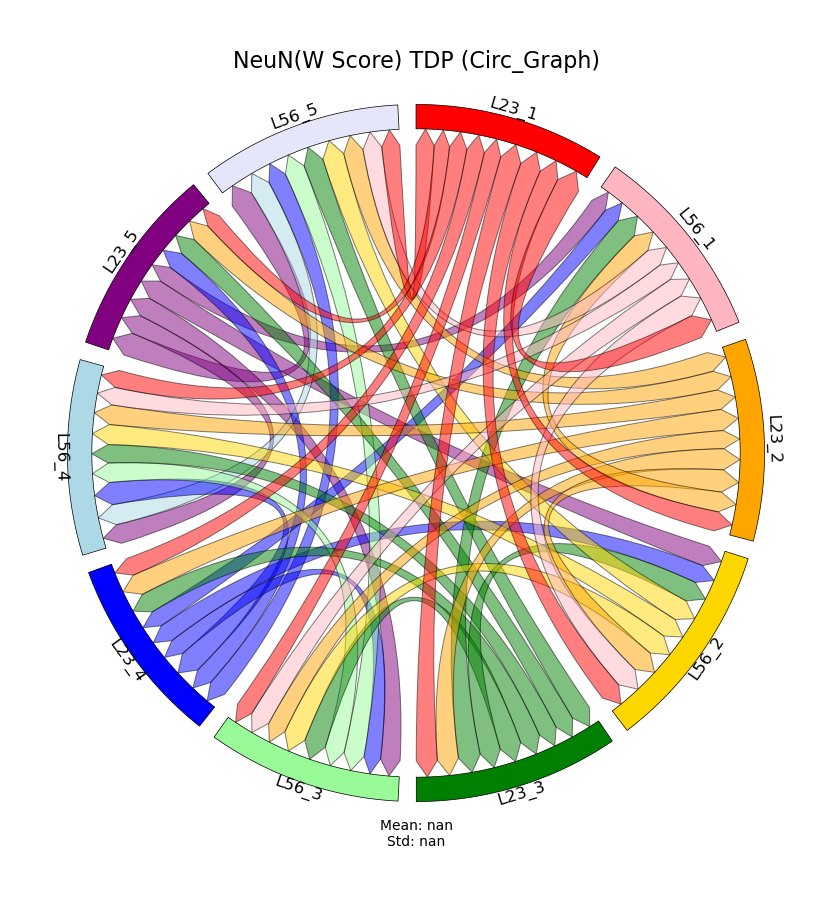

In [140]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False)

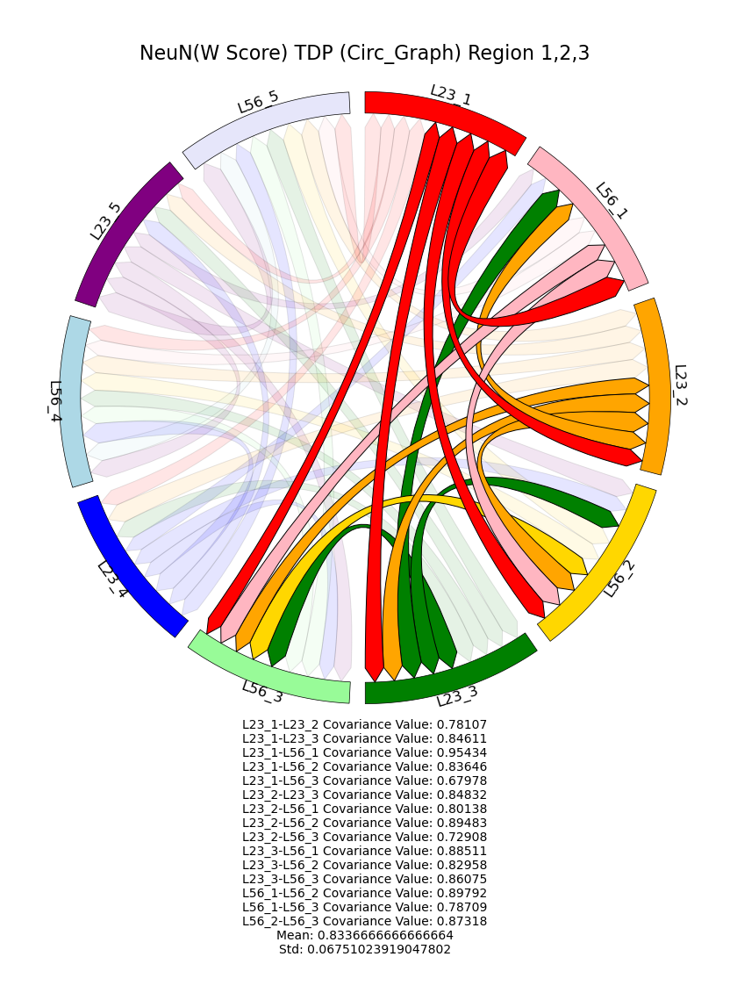

In [141]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Region 1,2,3", layer_Fig, long_track, short_track,
                region_spe = reg_123,
                cmp = False, fixed_density = False, region=True)

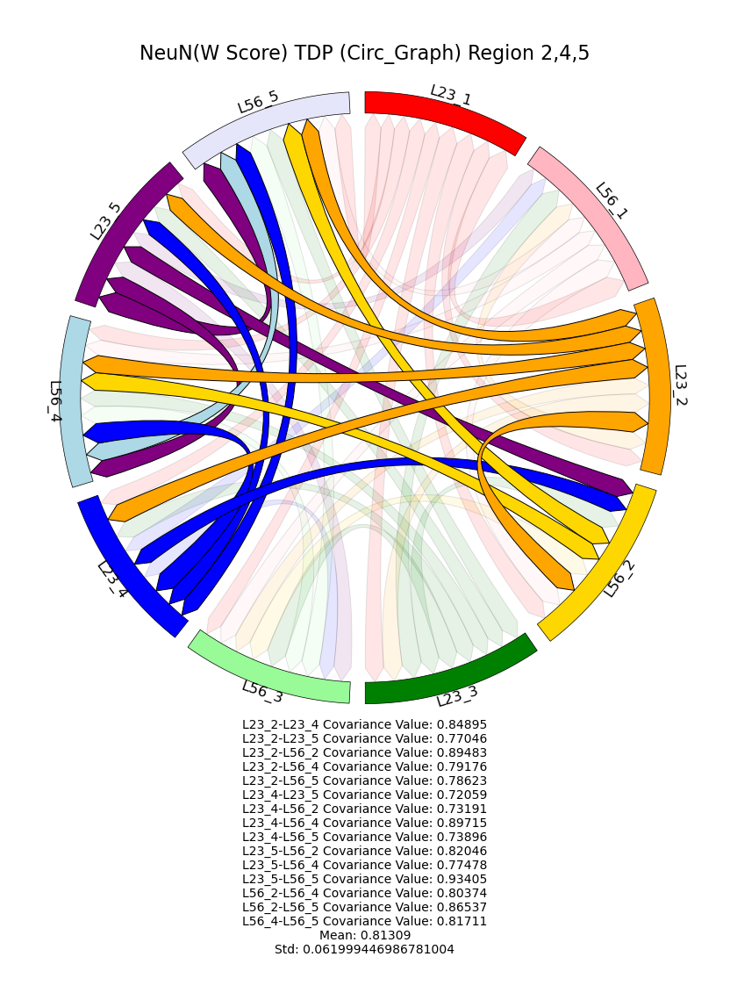

In [142]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Region 2,4,5", layer_Fig, long_track, short_track,
                region_spe = reg_245,
                cmp = False, fixed_density = False, region=True)

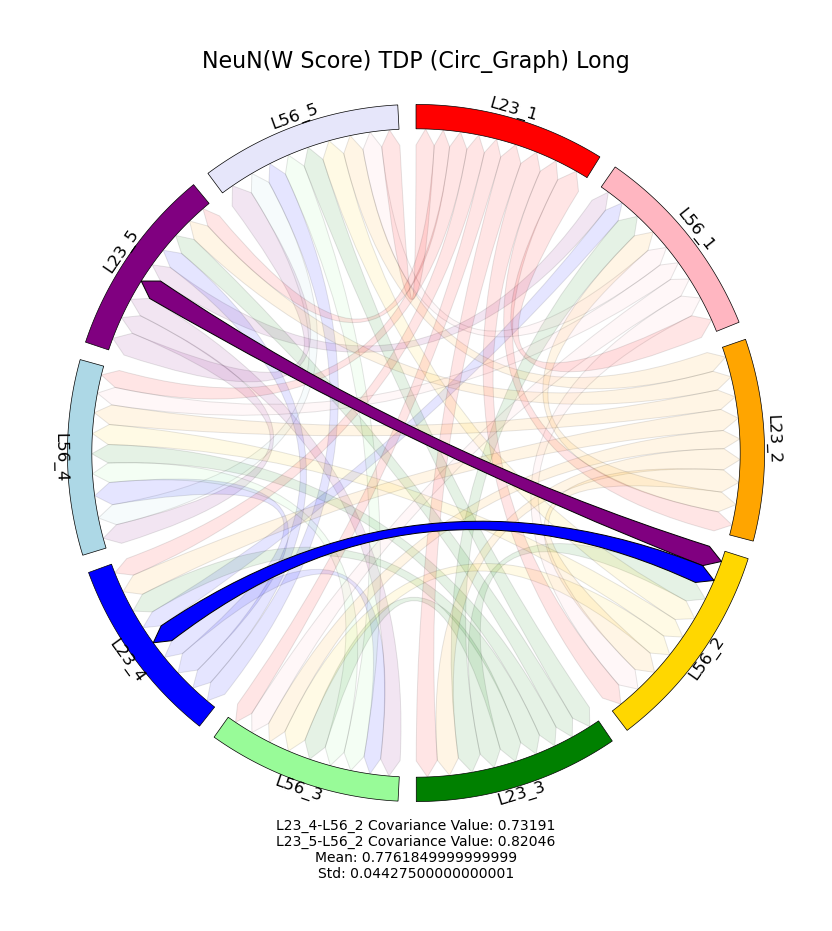

In [143]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, long=True)

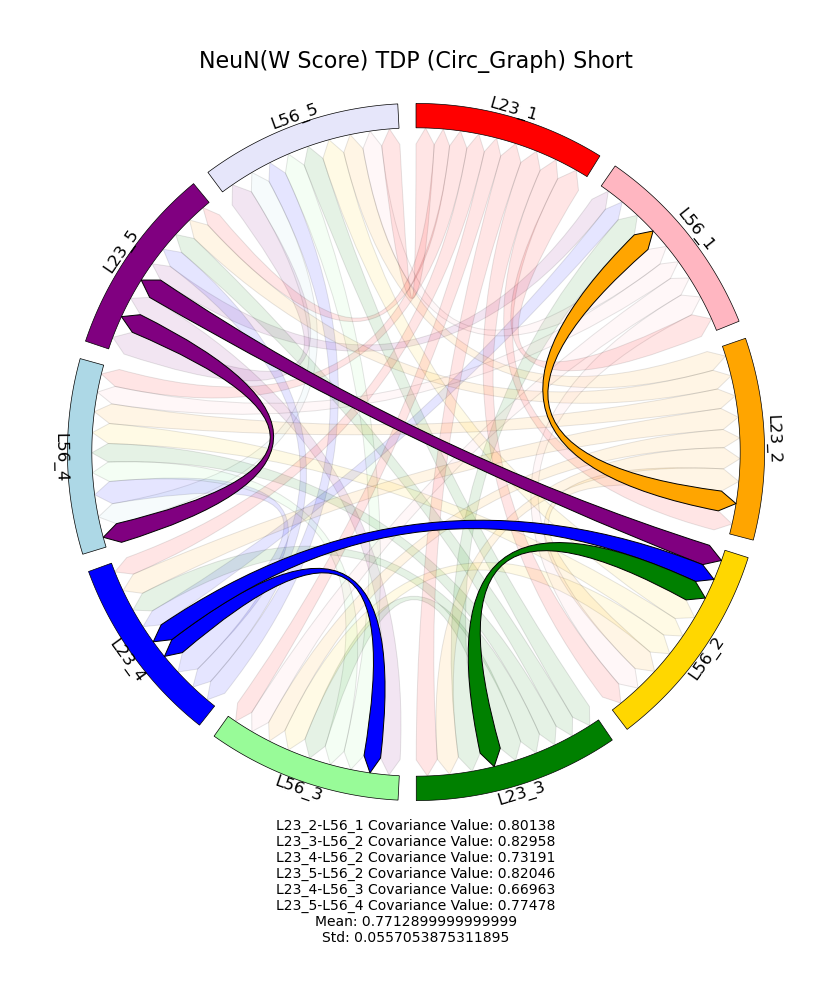

In [144]:
cp.circularPlot(cov_dict['TDP'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                cmp = False, fixed_density = False, short=True)

## HC > Tau

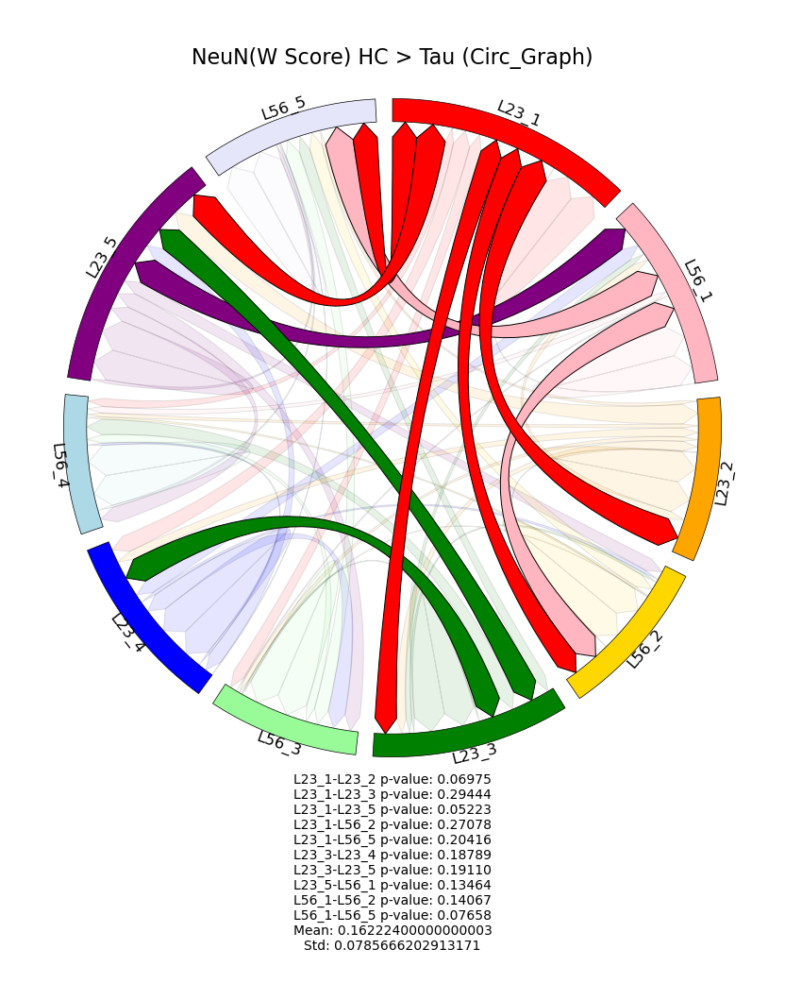

In [145]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

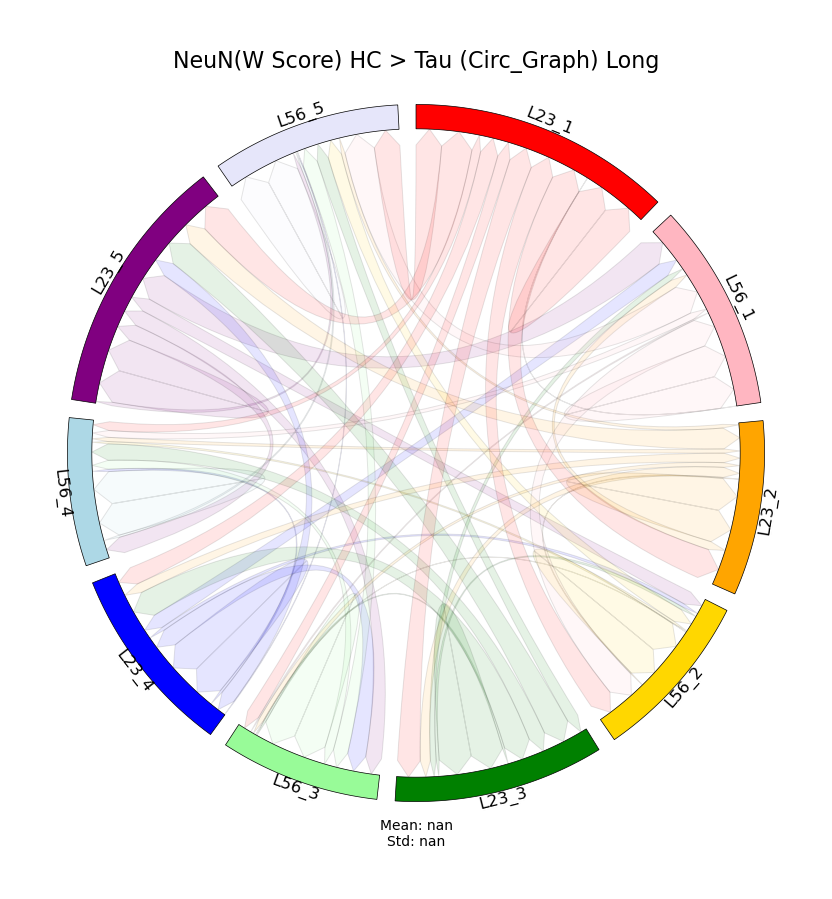

In [146]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

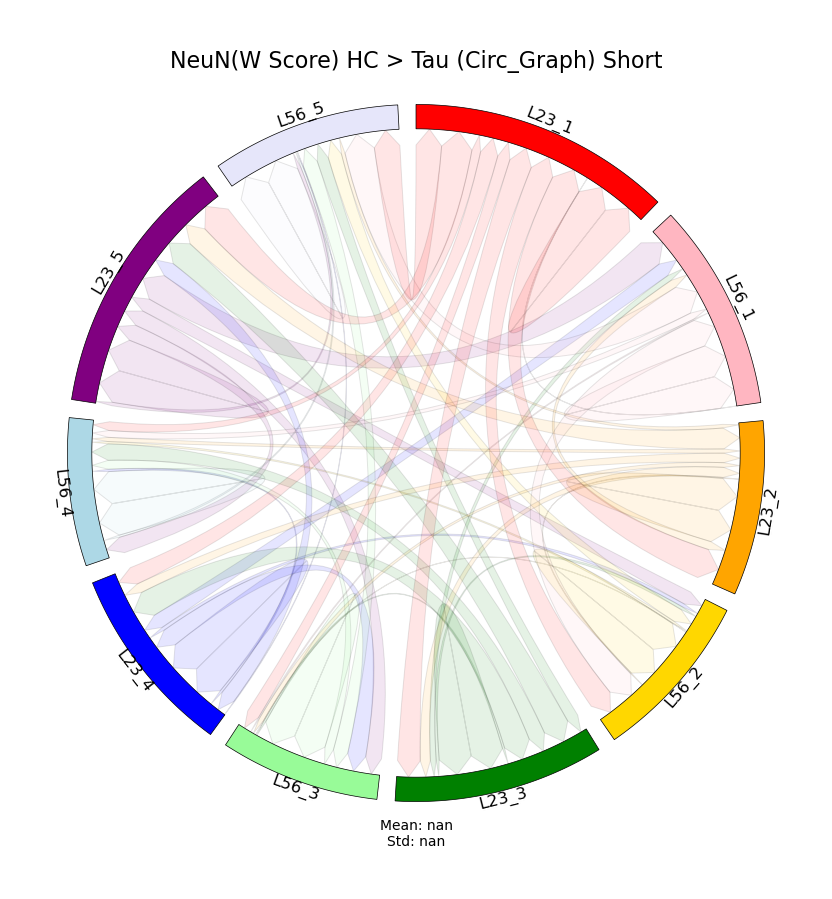

In [147]:
cp.circularPlot(cov_dict['TAU_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > Tau (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## Tau > HC

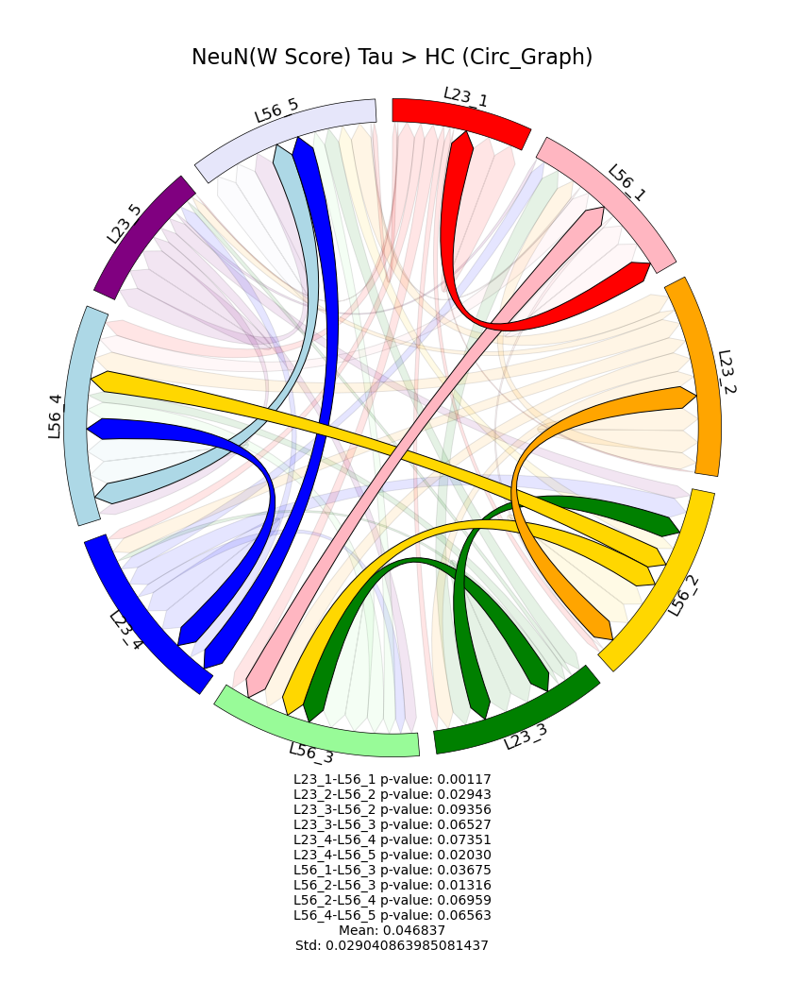

In [148]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

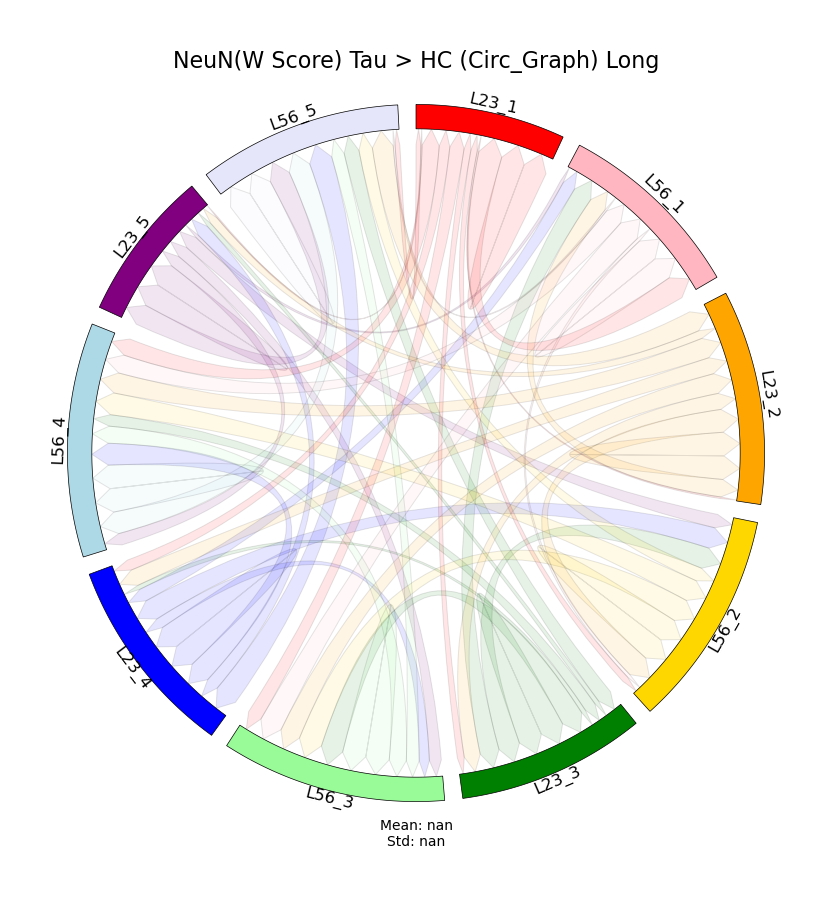

In [149]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

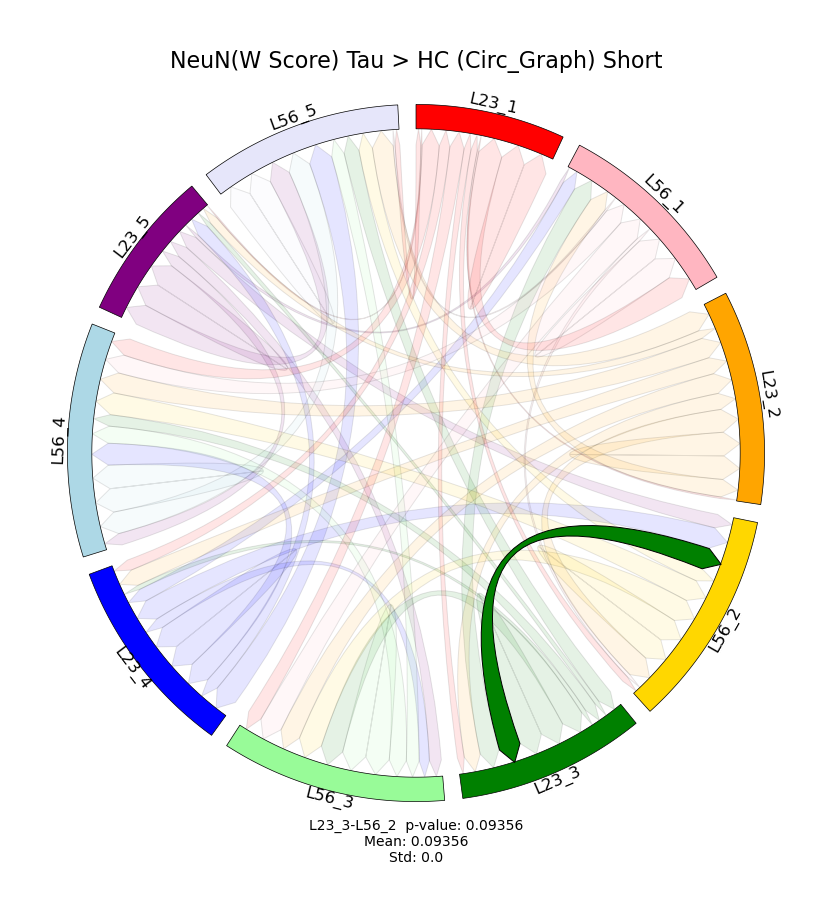

In [150]:
cp.circularPlot(cov_dict['TAU_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## HC > TDP

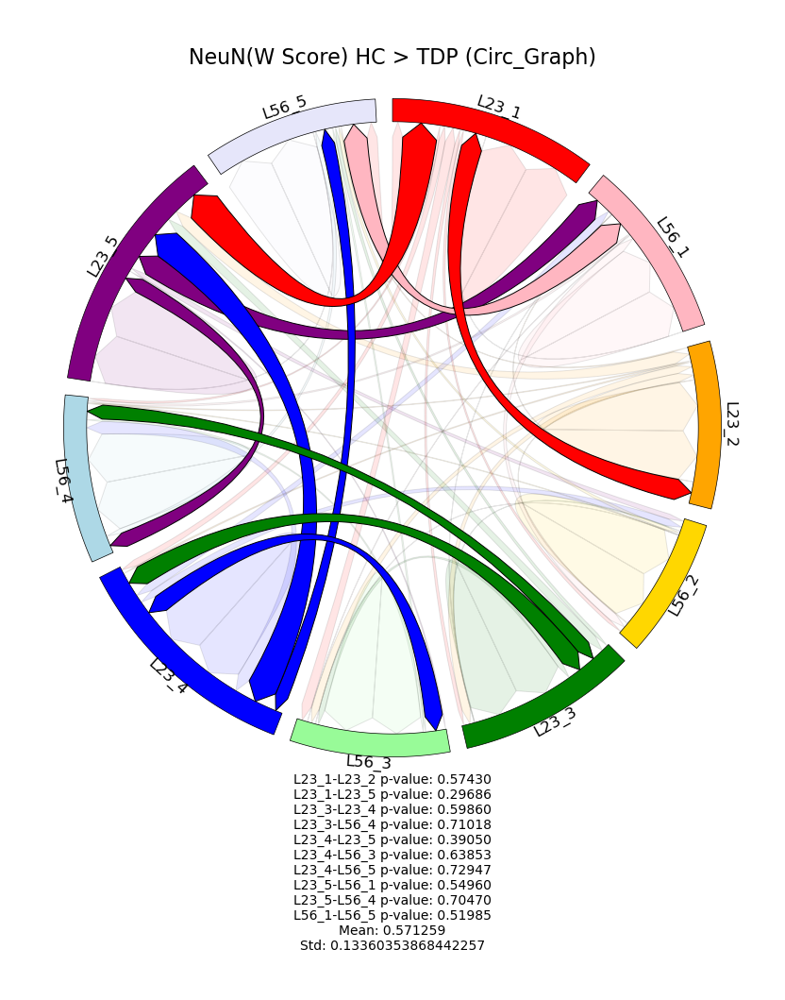

In [151]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

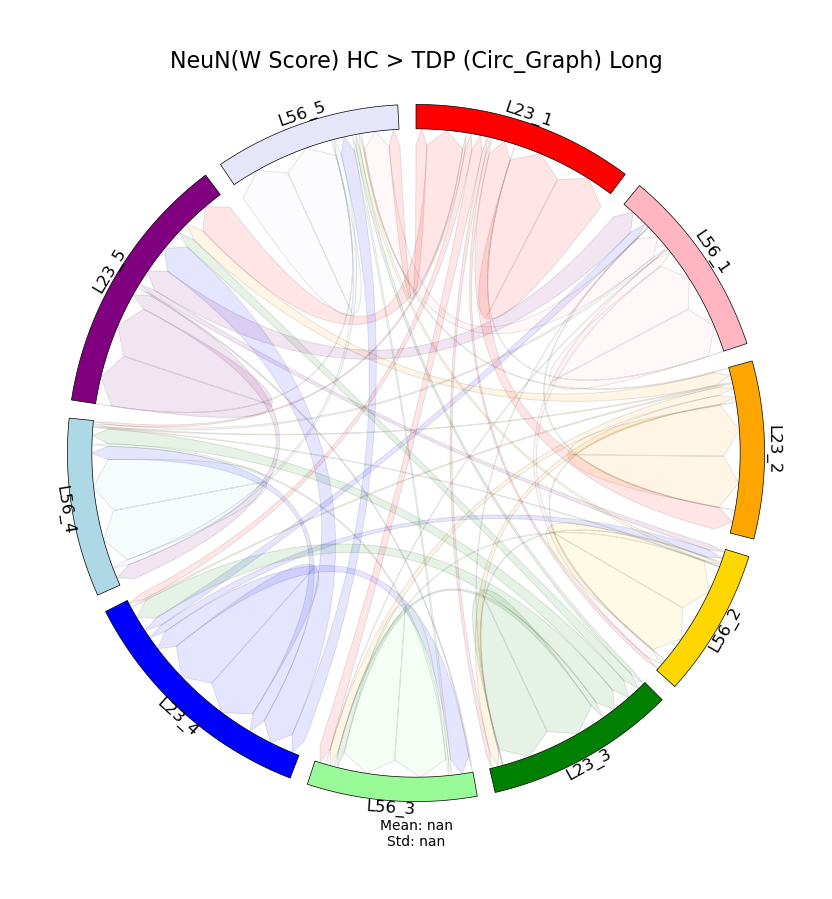

In [152]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

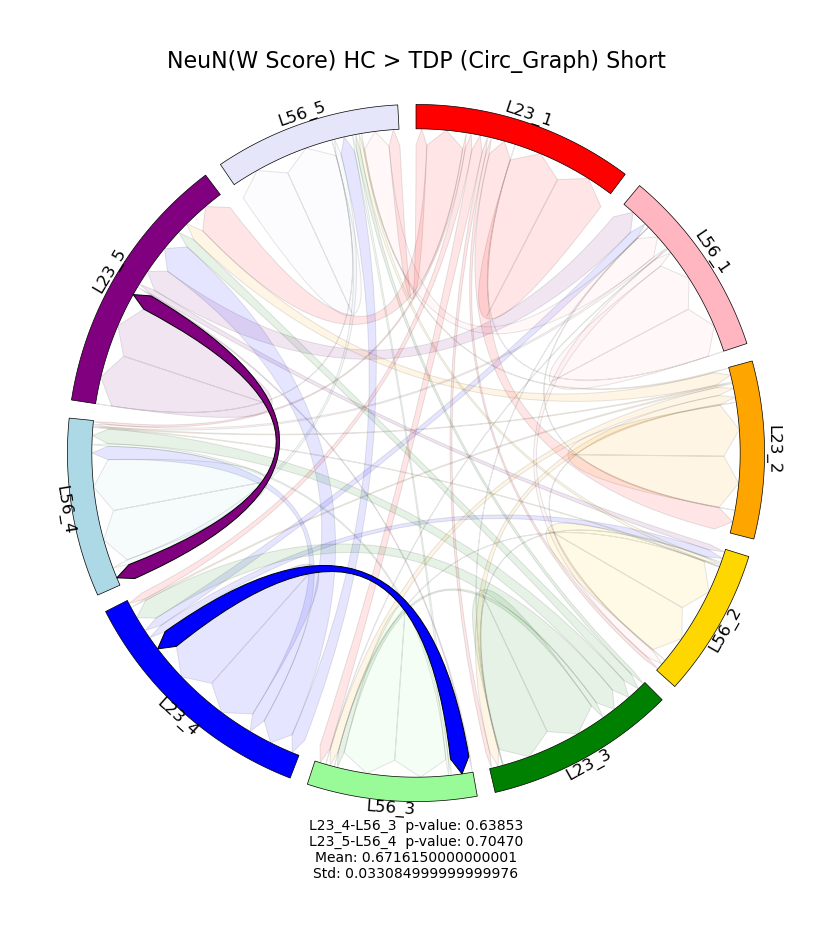

In [153]:
cp.circularPlot(cov_dict['TDP_lt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " HC > TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## TDP > HC

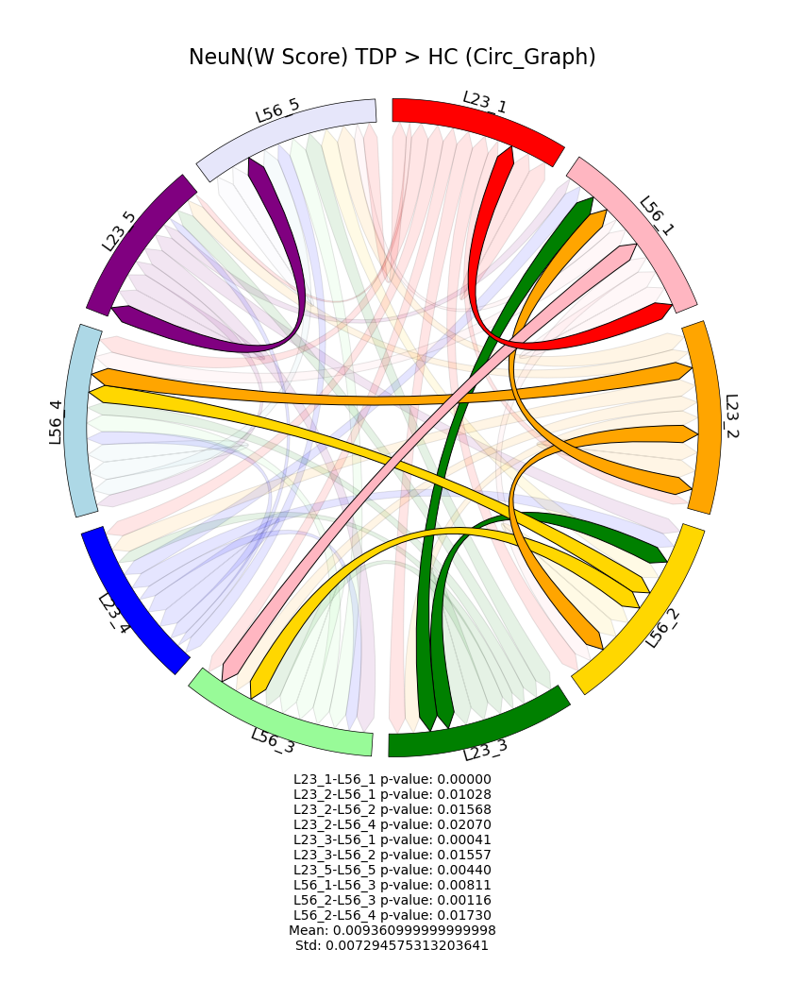

In [154]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

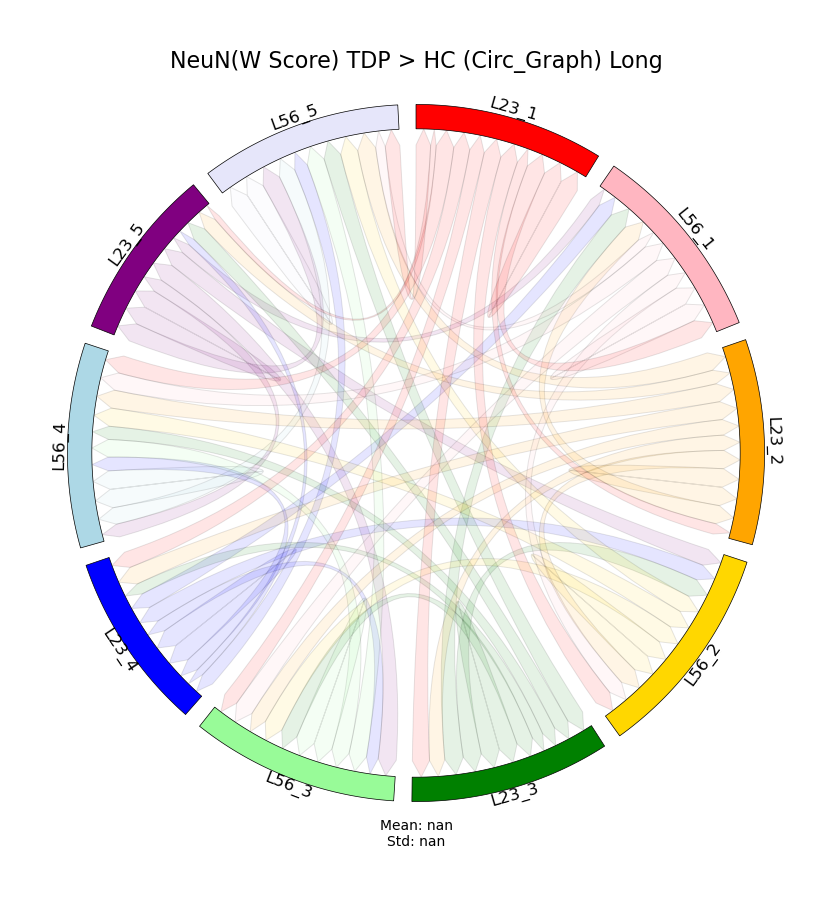

In [155]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

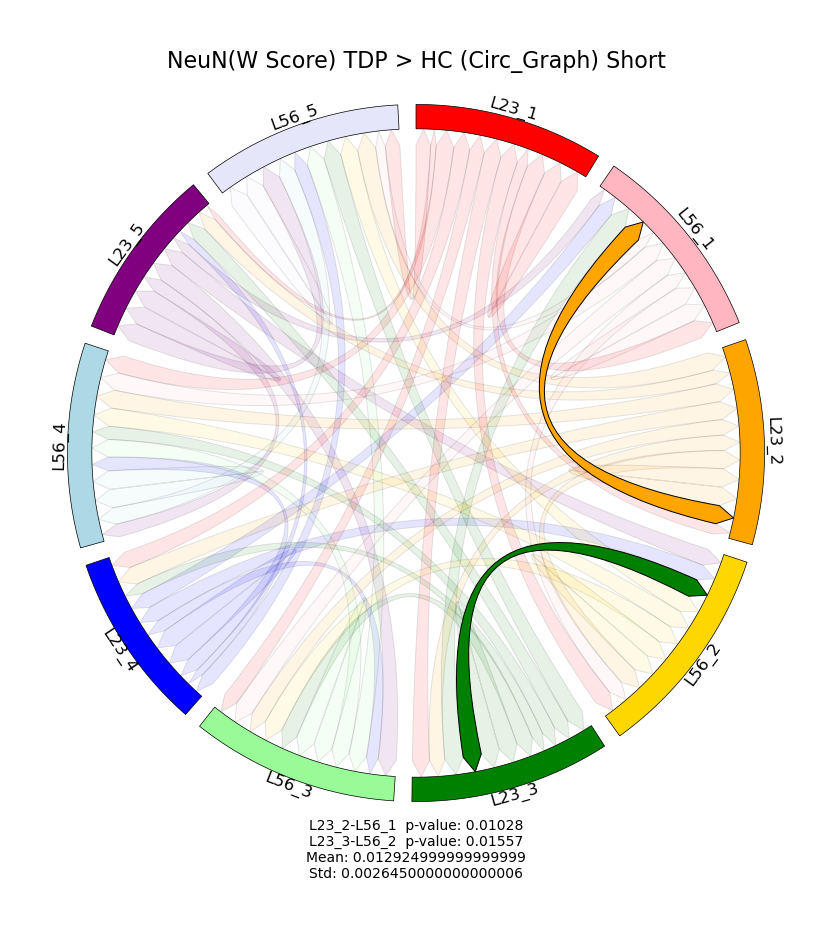

In [156]:
cp.circularPlot(cov_dict['TDP_gt_HC_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > HC (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## Tau > TDP

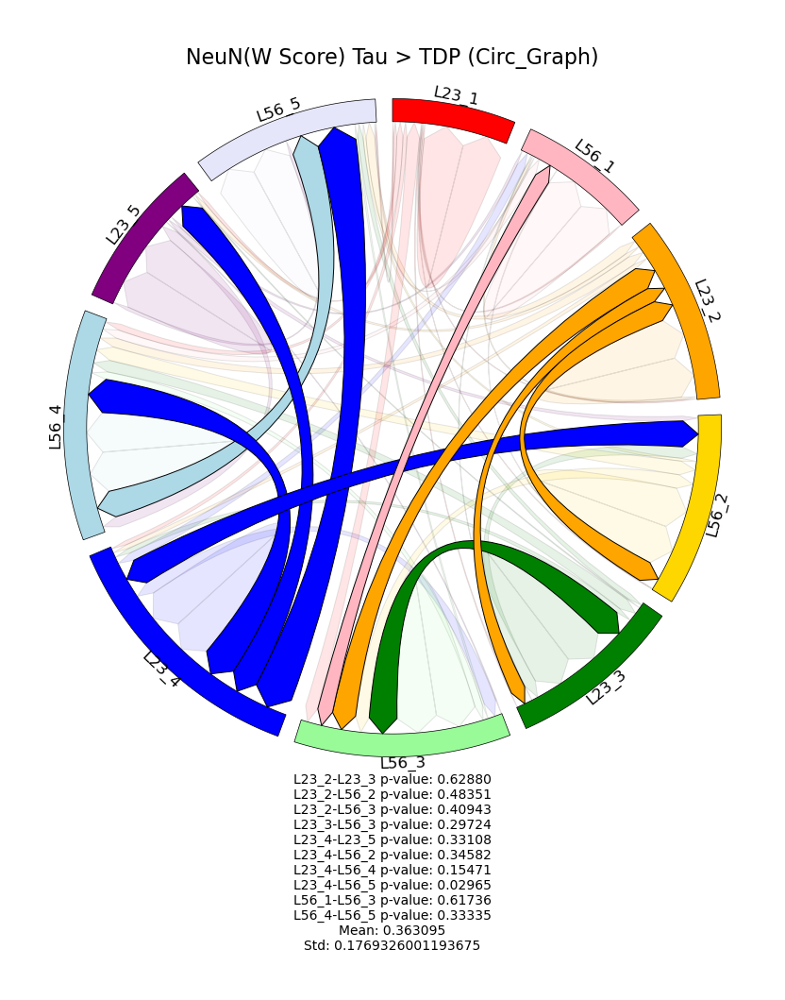

In [157]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

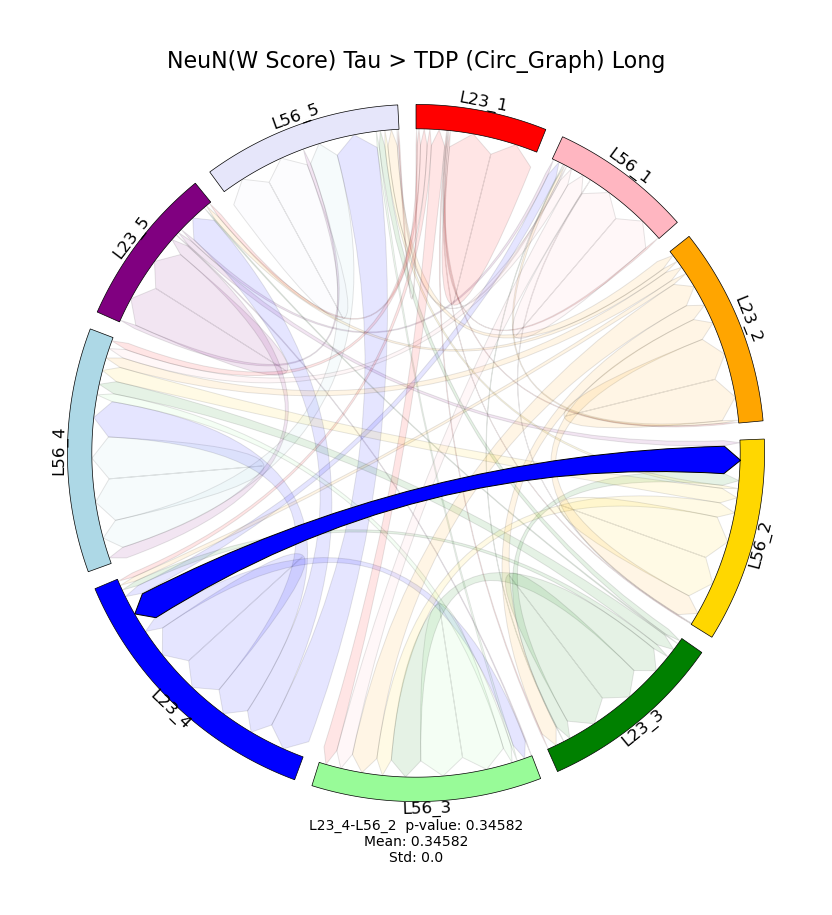

In [158]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

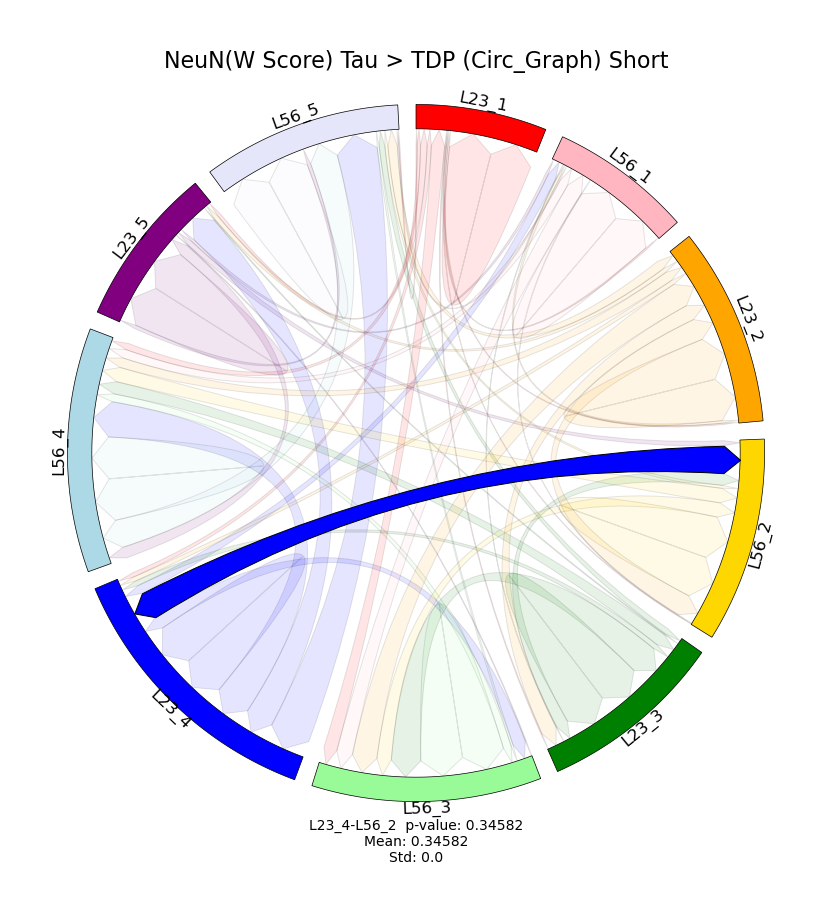

In [159]:
cp.circularPlot(cov_dict['TAU_gt_TDP_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " Tau > TDP (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

## TDP > Tau

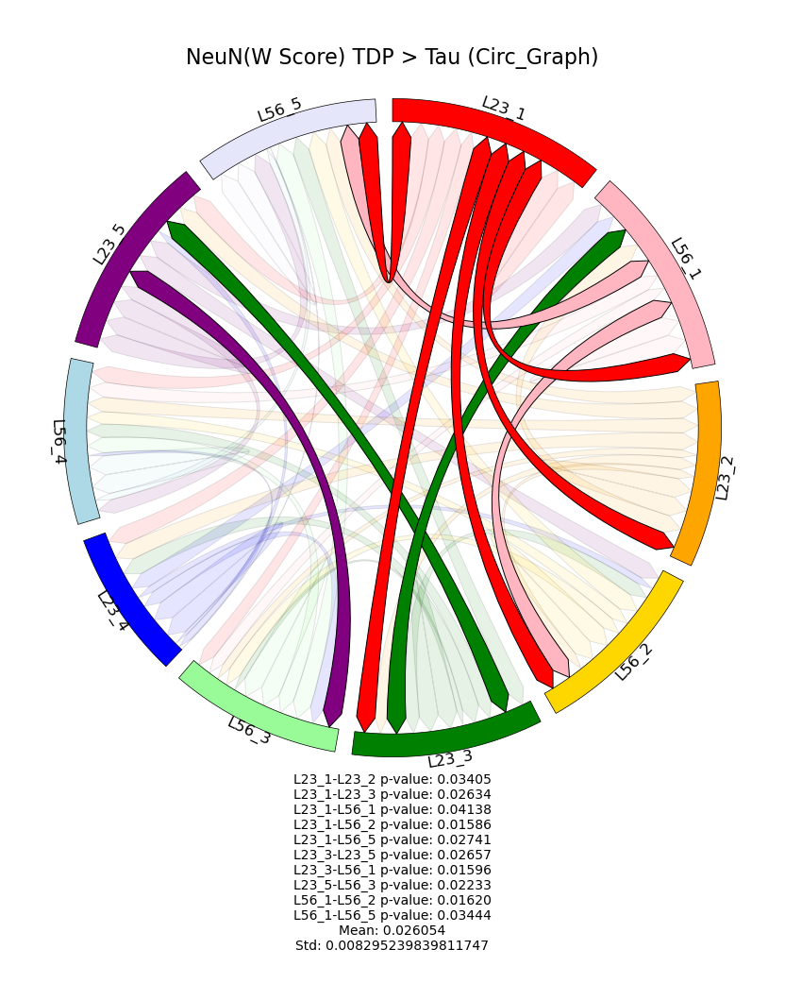

In [160]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph)", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True)

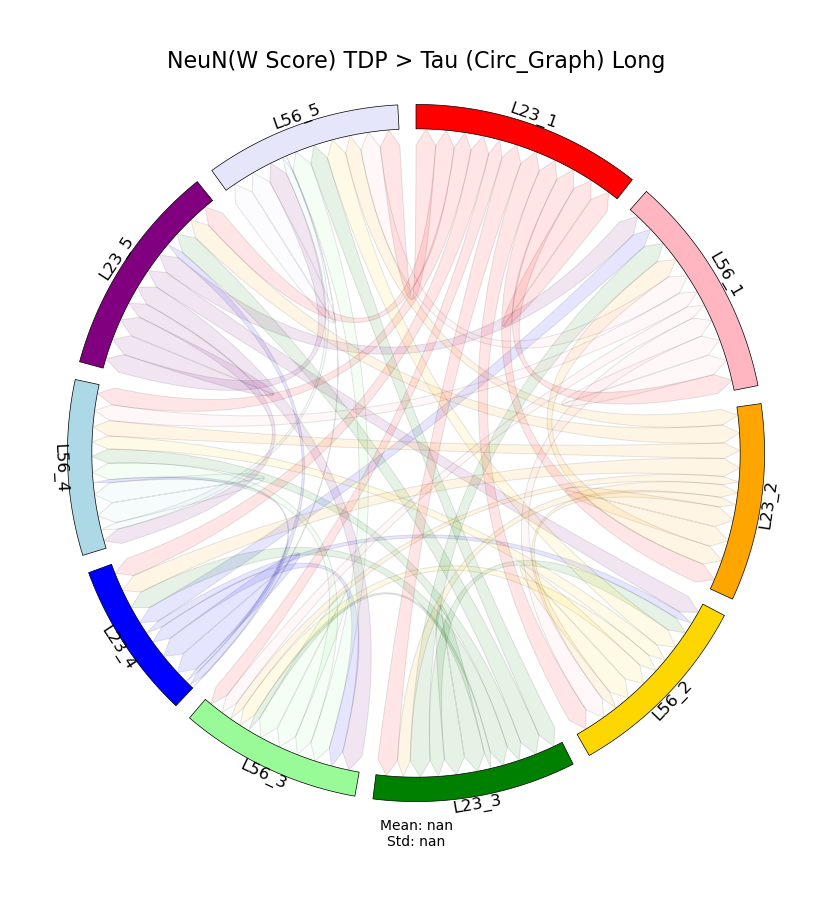

In [161]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph) Long", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, long=True)

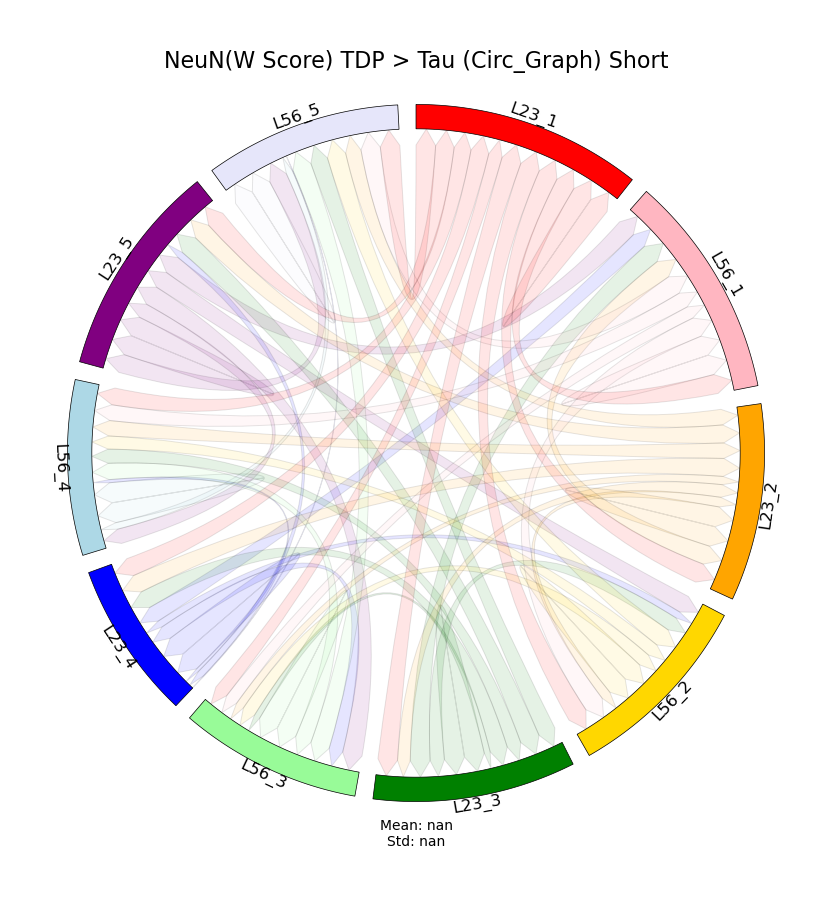

In [162]:
cp.circularPlot(cov_dict['TDP_gt_TAU_raw'], data_label, labels_dict, order, color_dict, 
                neuron_type + " TDP > Tau (Circ_Graph) Short", layer_Fig, long_track, short_track,
                fd_val = fd_val, cmp = True, fixed_density = True, short=True)

# Things to do (12/7)

# Some of the connections to focus on [Done]

Longer range connections
* Region 2 layer56 <-> Region 4 or 5 layer 23

Relatively Long Connections
* Region 1 layer 56 <-> Region 2 layer 23
* Region 2 layer 56 <-> Region 3, 4, 5 layer 23
* Region 3 layer 56 <-> Region 4 layer 23
* Region 4 layer 56 <-> Region 5 layer 23

# Find metrics to model degeneration

* Direct paired differences as connections

Test for only HC, Tau, TDP

# Try generating with just [DONE]
* region 3, 2, 1 (6 nodes)

# Generate [DONE]
* Region 2, 4, 5 (6 nodes) --> Longer tracks (WM) therefore should show more up in Tau


# FIX color map [DONE]
 
# Network Structure --> Double 2 circle [DONE]


# Literature search
* ~ Structural MRI --> Covariance Network Analysis: How they interpret their results / Volume, thickness, shape (measurements that can be derived at each regions / NOT direct connections such as DTI).
* Structural similarity networks. (not covariance, calculate feature vectors on MRI)